**This notebook contains followings:**
* Data Merging
* Feature Extraction
* Results on All Datasets


In [1]:
#importing necessary libraries
import os
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import scipy
import random
from scipy.stats import entropy
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,f1_score
from sklearn import preprocessing
import xgboost as xgb
import catboost as cb
import lightgbm as lgbm
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
import plotly.express as px
import plotly.graph_objects as go
import optuna
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import hilbert, chirp
import fitter
from distfit import distfit
from lifelines.datasets import load_rossi
import re

# Merging Data

In [49]:
rng_bootstrap= pd.DataFrame(np.array([False, False]).reshape(1,2))
rng_bootstrap.iat[-1, -1]= True
print (rng_bootstrap)


       0     1
0  False  True


In [84]:
#Data paths XJTU Kaggle

# Root Mean Squared Sum
def calculate_rms(df):
    result = []
    for col in df:
        r = np.sqrt((df[col]**2).sum() / len(df[col]))
        result.append(r)
    return result

# extract peak-to-peak features
def calculate_p2p(df):
    return np.array(df.max().abs() + df.min().abs())

# extract shannon entropy (cut signals to 500 bins)
def calculate_entropy(df):
    ent = []
    for col in df:
        ent.append(entropy(pd.cut(df[col], 500).value_counts()))
    return np.array(ent)
# extract clearence factor
def calculate_clearence(df):
    result = []
    for col in df:
        r = ((np.sqrt(df[col].abs())).sum() / len(df[col]))**2
        result.append(r)
    return result

def time_features(dataset_path, bootstrap= 0):
    features = ['mean','std','skew','kurtosis','entropy','rms','max','p2p', 'crest', 'clearence', 'shape', 'impulse', 
                "freq_band_1" , "freq_band_2" , "freq_band_3" , "freq_band_4" , "freq_band_5", "Event", "Survival_time"]
    cols2 = ['B1', 'B2']

    data_total= []

    #From the specs of XJTU dataset 25.6 kHz
    Fsamp = 25600

    Ts = 1/Fsamp
    
    # initialize
    columns = [c+'_'+tf for c in cols2 for tf in features]
    data = pd.DataFrame(columns=columns)
     
    for filename in os.listdir(dataset_path):
    
        raw_data = pd.read_csv(os.path.join(dataset_path, filename), sep=',')

        timeline= int(re.sub('.csv*', '', filename))

        # time features
        mean_abs = np.array(raw_data.abs().mean())
        std = np.array(raw_data.std())
        skew = np.array(raw_data.skew())
        kurtosis = np.array(raw_data.kurtosis())
        entropy = calculate_entropy(raw_data)
        rms = np.array(calculate_rms(raw_data))
        max_abs = np.array(raw_data.abs().max())
        p2p = calculate_p2p(raw_data)
        crest = max_abs/rms
        clearence = np.array(calculate_clearence(raw_data))
        shape = rms / mean_abs
        impulse = max_abs / mean_abs

        h_signal = np.abs(hilbert(raw_data))
        N = len(h_signal)
        fft = np.abs(np.fft.fft(h_signal) /len (h_signal))
        fft= 2 * fft [0:int(N/2+1)]
        fft[0]= fft[0] / 2
        # Excluding continuous representation
        start_freq_interested = [9, 26, 230, 272, 291]
        end_freq_interested = [21, 40, 242, 284, 305]
        fft_n = [None] * 5
        i = 0
        for index_s in start_freq_interested:
            index_e= end_freq_interested[i]
            temp_mean = fft [index_s : index_e]
            fft_n [i]= np.mean(temp_mean, axis= 0) 
            i += 1

        mean_abs = pd.DataFrame(mean_abs.reshape(1,2), columns=[c+'_mean' for c in cols2])
        std = pd.DataFrame(std.reshape(1,2), columns=[c+'_std' for c in cols2])
        skew = pd.DataFrame(skew.reshape(1,2), columns=[c+'_skew' for c in cols2])
        kurtosis = pd.DataFrame(kurtosis.reshape(1,2), columns=[c+'_kurtosis' for c in cols2])
        entropy = pd.DataFrame(entropy.reshape(1,2), columns=[c+'_entropy' for c in cols2])
        rms = pd.DataFrame(rms.reshape(1,2), columns=[c+'_rms' for c in cols2])
        max_abs = pd.DataFrame(max_abs.reshape(1,2), columns=[c+'_max' for c in cols2])
        p2p = pd.DataFrame(p2p.reshape(1,2), columns=[c+'_p2p' for c in cols2])
        crest = pd.DataFrame(crest.reshape(1,2), columns=[c+'_crest' for c in cols2])
        clearence = pd.DataFrame(clearence.reshape(1,2), columns=[c+'_clearence' for c in cols2])
        shape = pd.DataFrame(shape.reshape(1,2), columns=[c+'_shape' for c in cols2])
        impulse = pd.DataFrame(impulse.reshape(1,2), columns=[c+'_impulse' for c in cols2])
        fft_1 = pd.DataFrame(fft_n [0].reshape(1,2), columns=[c+'_freq_band_1' for c in cols2])
        fft_2 = pd.DataFrame(fft_n [1].reshape(1,2), columns=[c+'_freq_band_2' for c in cols2])
        fft_3 = pd.DataFrame(fft_n [2].reshape(1,2), columns=[c+'_freq_band_3' for c in cols2])
        fft_4 = pd.DataFrame(fft_n [3].reshape(1,2), columns=[c+'_freq_band_4' for c in cols2])
        fft_5 = pd.DataFrame(fft_n [4].reshape(1,2), columns=[c+'_freq_band_5' for c in cols2])
        event = pd.DataFrame(np.array([False, False]).reshape(1,2), columns=[c+'_Event' for c in cols2])
        survt = pd.DataFrame(np.array([0, 0]).reshape(1,2), columns=[c+'_Survival_time' for c in cols2])

        mean_abs.index = [timeline]
        std.index = [timeline]
        skew.index = [timeline]
        kurtosis.index = [timeline]
        entropy.index = [timeline]
        rms.index = [timeline]
        max_abs.index = [timeline]
        p2p.index = [timeline]
        crest.index = [timeline]
        clearence.index = [timeline]
        shape.index = [timeline]
        impulse.index = [timeline]
        fft_1.index = [timeline]
        fft_2.index = [timeline]
        fft_3.index = [timeline] 
        fft_4.index = [timeline]
        fft_5.index = [timeline]
        event.index = [timeline]
        survt.index = [timeline]      
        
        # concat
        merge = pd.concat([mean_abs, std, skew, kurtosis, entropy, rms, max_abs, p2p,crest,clearence, shape, impulse, 
                        fft_1, fft_2, fft_3, fft_4, fft_5, event, survt], axis=1)
        data = pd.concat([data,merge])

    cols = [c+'_'+tf for c in cols2 for tf in features]
    data = data[cols]
    data.sort_index(inplace= True)
    data.reset_index(inplace= True, drop=True)  

    rng_bootstrap = np.random.permutation([-4, -3, -2, -1, 1, 2, 3, 4])
    rng_bootstrap = rng_bootstrap[:bootstrap]

    for boot_num in range (0, bootstrap + 2 , 1):
        
        if boot_num == 0:
            data_boot= data
            data_boot.iat[-1, 17]= True
            data_boot.iat[-1, -2]= True
            data.iat[-1, 17]= False
            data.iat[-1, -2]= False
            data_total.append(data_boot)
        elif boot_num > 0 and boot_num < bootstrap + 1:
            if (rng_bootstrap [boot_num - 1] < 0):
                data_boot= data
                data_boot= data_boot.iloc[-(rng_bootstrap[boot_num - 1]) : , :]
            else:
                data_boot= data
                data_aux = pd.DataFrame(data_boot[-1:].values, columns= data.columns)
                data_aux.iat[-1, 17]= False   
                data_aux.iat[-1, -2]= False            
                for boot_adder in range (0, rng_bootstrap[boot_num - 1], 1):
                    data_boot = data_boot.append(data_aux)
            data_boot.reset_index(inplace= True, drop=True)
            data_boot.iat[-1, 17]= True
            data_boot.iat[-1, -2]= True
            data_total.append(data_boot)
        elif boot_num == bootstrap + 1:
            data_total.append(data)

    rng_bootstrap= np.append(rng_bootstrap, random.randint(-4, -1))
    rng_bootstrap = pd.DataFrame(rng_bootstrap, columns= ["Bootstrap values"])  

    return data_total, rng_bootstrap


In [85]:
bootno = 2
bearings = 5
j = 1

for bearing in range (1, bearings + 1 , 1):

    dataset_path = "./data/XJTU-SY/35Hz12kN/Bearing1_" + str(bearing)
    datasets, bootstrap_val = time_features(dataset_path, bootstrap= bootno)
    i = 1
    for dataset in datasets:
        dataset.columns= ['B' + str(j) + '_mean' , 'B' + str(j) + '_std', 'B' + str(j) + '_skew', 'B' + str(j) + '_kurtosis', 'B' + str(j) + '_entropy', 
                          'B' + str(j) + '_rms','B' + str(j) + '_max', 'B' + str(j) + '_p2p', 'B' + str(j) + '_crest', 'B' + str(j) + '_clearence', 
                          'B' + str(j) + '_shape', 'B' + str(j) + '_impulse', 'B' + str(j) + '_freq_band_1', 'B' + str(j) + '_freq_band_2', 'B' + str(j) + '_freq_band_3', 
                          'B' + str(j) + '_freq_band_4', 'B' + str(j) + '_freq_band_5', 'B' + str(j) + '_Event', 'B' + str(j) + '_Survival_time',
                          'B' + str(j + 1) + '_mean', 'B' + str(j + 1) + '_std', 'B' + str(j + 1) + '_skew', 'B' + str(j + 1) + '_kurtosis', 'B' + str(j + 1) + '_entropy', 
                          'B' + str(j + 1) +'_rms', 'B' + str(j + 1) + '_max', 'B' + str(j + 1) + '_p2p', 'B' + str(j + 1) + '_crest' , 'B' + str(j + 1) + '_clearence', 
                          'B' + str(j + 1) + '_shape','B' + str(j + 1) + '_impulse', 'B' + str(j + 1) + '_freq_band_1' , 'B' + str(j + 1) + '_freq_band_2', 'B' + str(j + 1) + '_freq_band_3', 
                          'B' + str(j + 1) + '_freq_band_4' , 'B' + str(j + 1) + '_freq_band_5', 'B' + str(j + 1) + '_Event', 'B' + str(j + 1) + '_Survival_time']
            
        dataname= "./data/XJTU-SY/csv/Bearing1_" + str(bearing) + "_" + str(i) + "_timefeature.csv"
        dataset.to_csv(dataname, index= False)
        i += 1
        j += 2

    dataname= "./data/XJTU-SY/csv/Bearing1_" + str(bearing) + "_bootstrap.csv"
    bootstrap_val.to_csv(dataname, index= False)   

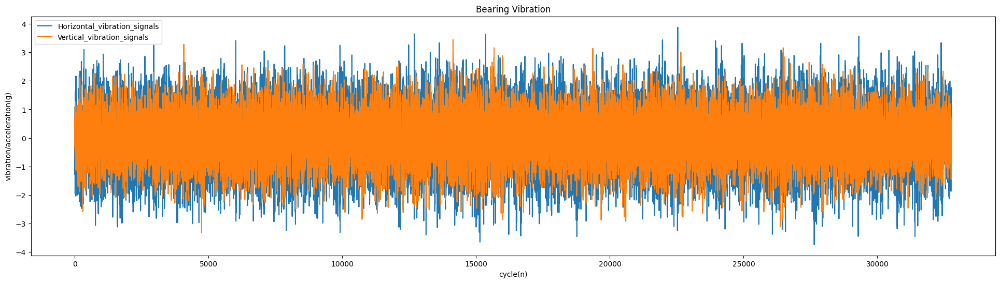

In [123]:
# Test for the first fil
dataset = pd.read_csv(dataset_path + '/1.csv')

ax = dataset.plot(figsize = (24,6), title= "Bearing Vibration" , legend = True)
ax.set(xlabel="cycle(n)", ylabel="vibration/acceleration(g)")
plt.show()

# Feature Extraction #

In [3]:
# # Root Mean Squared Sum
# def calculate_rms(df):
#     result = []
#     for col in df:
#         r = np.sqrt((df[col]**2).sum() / len(df[col]))
#         result.append(r)
#     return result

# # extract peak-to-peak features
# def calculate_p2p(df):
#     return np.array(df.max().abs() + df.min().abs())

# # extract shannon entropy (cut signals to 500 bins)
# def calculate_entropy(df):
#     ent = []
#     for col in df:
#         ent.append(entropy(pd.cut(df[col], 500).value_counts()))
#     return np.array(ent)
# # extract clearence factor
# def calculate_clearence(df):
#     result = []
#     for col in df:
#         r = ((np.sqrt(df[col].abs())).sum() / len(df[col]))**2
#         result.append(r)
#     return result

# def time_features(dataset_path, id_set=None):
#     features = ['mean','std','skew','kurtosis','entropy','rms','max','p2p', 'crest', 'clearence', 'shape', 'impulse', 
#                 "freq_band_1" , "freq_band_2" , "freq_band_3" , "freq_band_4" , "freq_band_5"]
#     cols1 = ['B1_x','B1_y','B2_x','B2_y','B3_x','B3_y','B4_x','B4_y']
#     cols2 = ['B1','B2','B3','B4']

#     #From the specs of Kaggle NASA dataset
#     Fsamp = 20000
#     Ts = 1/Fsamp
    
#     # initialize
#     if id_set == 1:
#         columns = [c+'_'+tf for c in cols1 for tf in features]
#         data = pd.DataFrame(columns=columns)
#     else:
#         columns = [c+'_'+tf for c in cols2 for tf in features]
#         data = pd.DataFrame(columns=columns)
        
        
#     for filename in os.listdir(dataset_path):
#         # read dataset
#         raw_data = pd.read_csv(os.path.join(dataset_path, filename), sep='\t')
        
#         # time features
#         mean_abs = np.array(raw_data.abs().mean())
#         std = np.array(raw_data.std())
#         skew = np.array(raw_data.skew())
#         kurtosis = np.array(raw_data.kurtosis())
#         entropy = calculate_entropy(raw_data)
#         rms = np.array(calculate_rms(raw_data))
#         max_abs = np.array(raw_data.abs().max())
#         p2p = calculate_p2p(raw_data)
#         crest = max_abs/rms
#         clearence = np.array(calculate_clearence(raw_data))
#         shape = rms / mean_abs
#         impulse = max_abs / mean_abs

#         h_signal = np.abs(hilbert(raw_data))
#         N = len(h_signal)
#         fft = np.abs(np.fft.fft(h_signal) /len (h_signal))
#         fft= 2 * fft [0:int(N/2+1)]
#         fft[0]= fft[0] / 2
#         # Excluding continuous representation
#         start_freq_interested = [9, 26, 230, 272, 291]
#         end_freq_interested = [21, 40, 242, 284, 305]
#         fft_n = [None] * 5
#         i = 0
#         for index_s in start_freq_interested:
#             index_e= end_freq_interested[i]
#             temp_mean = fft [index_s : index_e]
#             fft_n [i]= np.mean(temp_mean, axis= 0) 
#             i += 1

#         if id_set == 1:
#             mean_abs = pd.DataFrame(mean_abs.reshape(1,8), columns=[c+'_mean' for c in cols1])
#             std = pd.DataFrame(std.reshape(1,8), columns=[c+'_std' for c in cols1])
#             skew = pd.DataFrame(skew.reshape(1,8), columns=[c+'_skew' for c in cols1])
#             kurtosis = pd.DataFrame(kurtosis.reshape(1,8), columns=[c+'_kurtosis' for c in cols1])
#             entropy = pd.DataFrame(entropy.reshape(1,8), columns=[c+'_entropy' for c in cols1])
#             rms = pd.DataFrame(rms.reshape(1,8), columns=[c+'_rms' for c in cols1])
#             max_abs = pd.DataFrame(max_abs.reshape(1,8), columns=[c+'_max' for c in cols1])
#             p2p = pd.DataFrame(p2p.reshape(1,8), columns=[c+'_p2p' for c in cols1])
#             crest = pd.DataFrame(crest.reshape(1,8), columns=[c+'_crest' for c in cols1])
#             clearence = pd.DataFrame(clearence.reshape(1,8), columns=[c+'_clearence' for c in cols1])
#             shape = pd.DataFrame(shape.reshape(1,8), columns=[c+'_shape' for c in cols1])
#             impulse = pd.DataFrame(impulse.reshape(1,8), columns=[c+'_impulse' for c in cols1])
#             fft_1 = pd.DataFrame(fft_n [0].reshape(1,8), columns=[c+'_freq_band_1' for c in cols1])
#             fft_2 = pd.DataFrame(fft_n [1].reshape(1,8), columns=[c+'_freq_band_2' for c in cols1])
#             fft_3 = pd.DataFrame(fft_n [2].reshape(1,8), columns=[c+'_freq_band_3' for c in cols1])
#             fft_4 = pd.DataFrame(fft_n [3].reshape(1,8), columns=[c+'_freq_band_4' for c in cols1])
#             fft_5 = pd.DataFrame(fft_n [4].reshape(1,8), columns=[c+'_freq_band_5' for c in cols1])

            
#         else:
#             mean_abs = pd.DataFrame(mean_abs.reshape(1,4), columns=[c+'_mean' for c in cols2])
#             std = pd.DataFrame(std.reshape(1,4), columns=[c+'_std' for c in cols2])
#             skew = pd.DataFrame(skew.reshape(1,4), columns=[c+'_skew' for c in cols2])
#             kurtosis = pd.DataFrame(kurtosis.reshape(1,4), columns=[c+'_kurtosis' for c in cols2])
#             entropy = pd.DataFrame(entropy.reshape(1,4), columns=[c+'_entropy' for c in cols2])
#             rms = pd.DataFrame(rms.reshape(1,4), columns=[c+'_rms' for c in cols2])
#             max_abs = pd.DataFrame(max_abs.reshape(1,4), columns=[c+'_max' for c in cols2])
#             p2p = pd.DataFrame(p2p.reshape(1,4), columns=[c+'_p2p' for c in cols2])
#             crest = pd.DataFrame(crest.reshape(1,4), columns=[c+'_crest' for c in cols2])
#             clearence = pd.DataFrame(clearence.reshape(1,4), columns=[c+'_clearence' for c in cols2])
#             shape = pd.DataFrame(shape.reshape(1,4), columns=[c+'_shape' for c in cols2])
#             impulse = pd.DataFrame(impulse.reshape(1,4), columns=[c+'_impulse' for c in cols2])
#             fft_1 = pd.DataFrame(fft_n [0].reshape(1,4), columns=[c+'_freq_band_1' for c in cols2])
#             fft_2 = pd.DataFrame(fft_n [1].reshape(1,4), columns=[c+'_freq_band_2' for c in cols2])
#             fft_3 = pd.DataFrame(fft_n [2].reshape(1,4), columns=[c+'_freq_band_3' for c in cols2])
#             fft_4 = pd.DataFrame(fft_n [3].reshape(1,4), columns=[c+'_freq_band_4' for c in cols2])
#             fft_5 = pd.DataFrame(fft_n [4].reshape(1,4), columns=[c+'_freq_band_5' for c in cols2])

#         mean_abs.index = [filename]
#         std.index = [filename]
#         skew.index = [filename]
#         kurtosis.index = [filename]
#         entropy.index = [filename]
#         rms.index = [filename]
#         max_abs.index = [filename]
#         p2p.index = [filename]
#         crest.index = [filename]
#         clearence.index = [filename]
#         shape.index = [filename]
#         impulse.index = [filename]
#         fft_1.index = [filename]
#         fft_2.index = [filename]
#         fft_3.index = [filename] 
#         fft_4.index = [filename]
#         fft_5.index = [filename]    
        
#         # concat
#         merge = pd.concat([mean_abs, std, skew, kurtosis, entropy, rms, max_abs, p2p,crest,clearence, shape, impulse, 
#                            fft_1, fft_2, fft_3, fft_4, fft_5], axis=1)
#         data = pd.concat([data,merge])
        
#     if id_set == 1:
#         cols = [c+'_'+tf for c in cols1 for tf in features]
#         data = data[cols]
#     else:
#         cols = [c+'_'+tf for c in cols2 for tf in features]
#         data = data[cols]
        
#     data.index = pd.to_datetime(data.index, format='%Y.%m.%d.%H.%M.%S')
#     data = data.sort_index()
#     return data                                  

Reading Data again

In [86]:
data_sample = pd.read_csv("./data/XJTU-SY/csv/Bearing1_1_1_timefeature.csv")
print (data_sample)

      B1_mean    B1_std   B1_skew  B1_kurtosis  B1_entropy    B1_rms  \
0    0.449234  0.563851 -0.001797     0.071546    5.466980  0.563890   
1    0.469337  0.589035 -0.014992     0.138146    5.177755  0.589078   
2    0.469207  0.589543  0.022944     0.246480    5.222381  0.589536   
3    0.473610  0.597245  0.013574     0.248411    5.421274  0.597274   
4    0.479684  0.604529  0.036587     0.394161    5.084863  0.604645   
..        ...       ...       ...          ...         ...       ...   
118  2.598606  3.631924 -0.326276     2.178601    5.135965  3.632455   
119  2.760711  3.819661 -0.216943     1.819169    5.209615  3.819631   
120  2.900586  3.987385 -0.232640     1.754787    5.082078  3.987478   
121  3.172205  4.339416 -0.278732     1.564076    5.309246  4.339480   
122  5.390425  7.268389 -0.274637     1.509480    5.385543  7.268278   

        B1_max     B1_p2p  B1_crest  B1_clearence  ...  B2_clearence  \
0     2.529883   4.884219  4.486485      0.380476  ...      0.3

In [87]:
data_sample.describe()

,B1_mean,B1_std,B1_skew,B1_kurtosis,B1_entropy,B1_rms,B1_max,B1_p2p,B1_crest,B1_clearence,...,B2_crest,B2_clearence,B2_shape,B2_impulse,B2_freq_band_1,B2_freq_band_2,B2_freq_band_3,B2_freq_band_4,B2_freq_band_5,B2_Survival_time
count,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,...,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.000000,123.0
mean,1.243809,1.679279,-0.085540,1.951249,4.955486,1.679512,11.636979,21.722968,7.740255,1.013152,...,5.196278,0.844917,1.257925,6.542198,0.000058,0.000053,0.000060,0.000057,0.000057,0.0
std,0.935740,1.298216,0.115704,0.816020,0.188040,1.298084,7.131382,13.548598,1.800652,0.747354,...,0.850127,0.601891,0.011951,1.107851,0.000059,0.000048,0.000061,0.000062,0.000053,0.0
min,0.449234,0.563851,-0.326276,0.071546,4.536899,0.563890,2.529883,4.884219,4.486485,0.380476,...,3.726763,0.379752,1.235628,4.617639,0.000009,0.000014,0.000013,0.000009,0.000015,0.0
25%,0.583761,0.758614,-0.219310,1.639394,4.802533,0.758763,6.340992,11.532718,6.323334,0.488022,...,4.620176,0.425307,1.248873,5.805984,0.000024,0.000024,0.000024,0.000025,0.000025,0.0
50%,0.616189,0.806464,-0.022078,1.819169,4.957494,0.806864,7.571578,13.770378,7.506153,0.509677,...,5.036348,0.433780,1.258616,6.344232,0.000032,0.000031,0.000034,0.000033,0.000032,0.0
75%,2.157352,2.939949,0.004519,2.277306,5.094439,2.939927,19.137877,36.178726,8.893275,1.743910,...,5.659649,1.448925,1.263909,7.113353,0.000076,0.000071,0.000074,0.000067,0.000071,0.0
max,5.390425,7.268389,0.110733,5.767132,5.466980,7.268278,35.597789,65.352583,15.334709,4.402638,...,7.758677,3.697840,1.304160,9.764087,0.000356,0.000245,0.000350,0.000474,0.000283,0.0


In [88]:
set_visual= data_sample [["B1_freq_band_1", "B1_freq_band_2", "B1_freq_band_3", "B1_freq_band_4", "B1_freq_band_5"]]
set_visual.describe()

,B1_freq_band_1,B1_freq_band_2,B1_freq_band_3,B1_freq_band_4,B1_freq_band_5
count,123.000000,123.000000,123.000000,123.000000,123.000000
mean,0.000138,0.000127,0.000139,0.000130,0.000130
std,0.000128,0.000102,0.000124,0.000116,0.000113
min,0.000029,0.000039,0.000033,0.000033,0.000040
25%,0.000058,0.000056,0.000058,0.000058,0.000059
50%,0.000078,0.000070,0.000078,0.000076,0.000076
75%,0.000182,0.000177,0.000191,0.000173,0.000162
max,0.000579,0.000496,0.000623,0.000765,0.000690


Plotting features of all bearings in both x and y axis

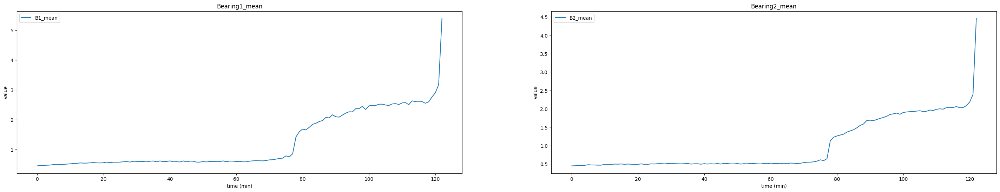

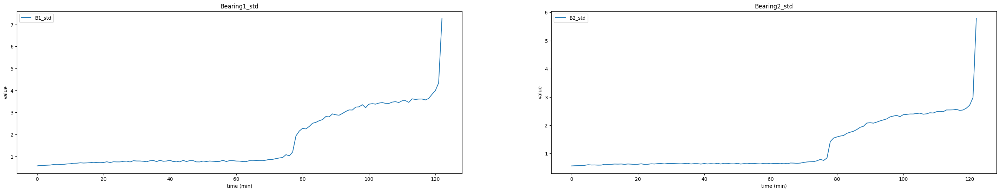

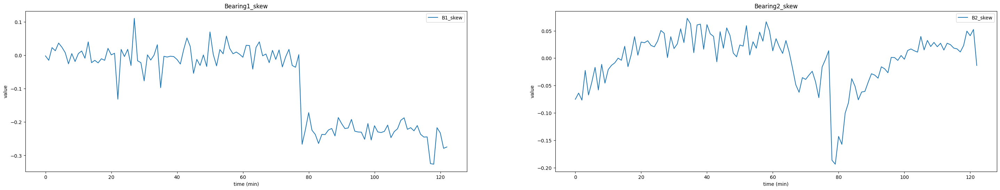

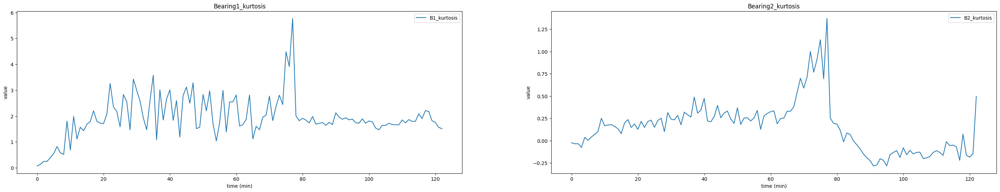

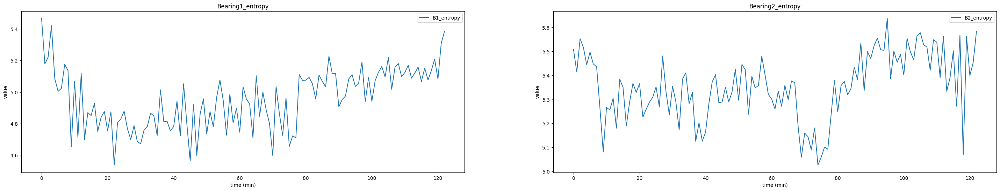

...

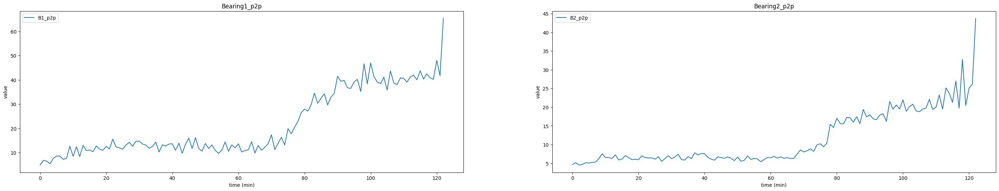

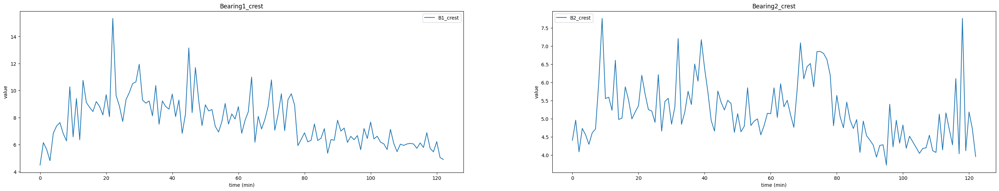

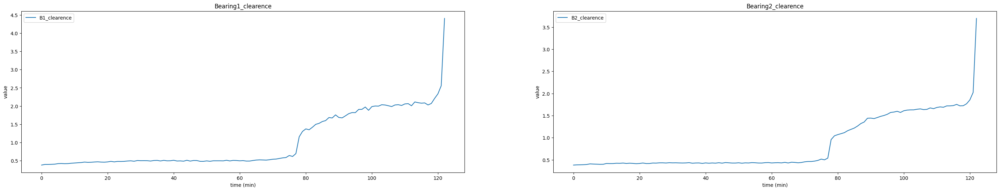

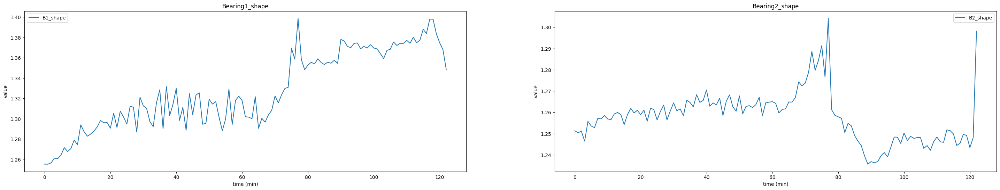

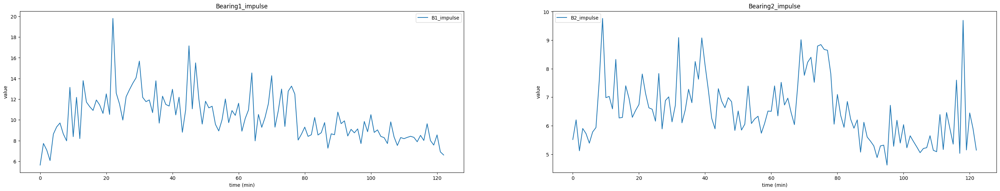

In [89]:
time_features_list = ["mean","std","skew","kurtosis","entropy","rms","max","p2p", "crest", "clearence", "shape", "impulse"]
bearings_xy = [["B"+str(n)+"_" for n in range(1,3)] for o in ['x','y'] ] 
#print(bearings_xy)
for tf in time_features_list:
    fig = plt.figure()
    # Divide the figure into a 1x4 grid, and give me the first section
    ax1 = fig.add_subplot(121)
    # Divide the figure into a 1x4 grid, and give me the second section
    ax2 = fig.add_subplot(122)
    #...so on
    # ax3 = fig.add_subplot(143)
    # ax4 = fig.add_subplot(144)
    # axes = [ax1,ax2,ax3, ax4]
    axes = [ax1,ax2]
        
    for i in range(2):
        col = bearings_xy[0][i]+tf
        data_sample[col].plot(figsize = (36,6), title="Bearing{}_".format(i+1)+tf , legend = True, ax=axes[i])
        # col = bearings_xy[1][i]+tf
        # set1[col].plot(figsize = (36,6) , legend = True, ax=axes[i])
        axes[i].set(xlabel="time (min)", ylabel="value")
        
    
    

In [129]:
# set1_hil= dataset.iloc[:,1]
# duration = 1
# fs = len(dataset)
# samples = int(fs*duration)
# t = np.arange(samples) / fs

In [24]:
# analytic_signal = hilbert(set1_hil)
# amplitude_envelope = np.abs(analytic_signal)
# instantaneous_phase = np.unwrap(np.angle(analytic_signal))
# instantaneous_frequency = (np.diff(instantaneous_phase) /
#                            (2.0*np.pi) * fs)

20479


In [156]:
dataset = pd.read_csv("./data/XJTU-SY/35Hz12kN/Bearing1_1/1.csv")
dataset_bad= pd.read_csv("./data/XJTU-SY/35Hz12kN/Bearing1_1/123.csv")

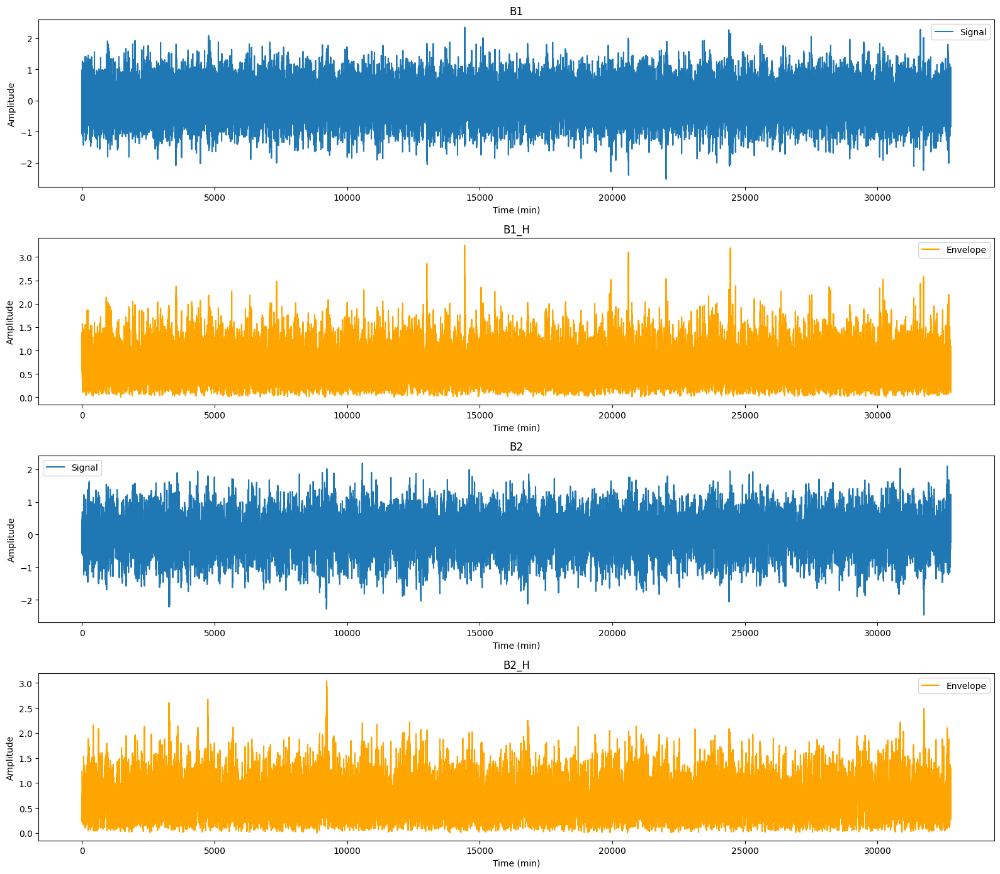

In [157]:
set1_pure= dataset.iloc[:,0]
h_signal_1 = np.abs(hilbert(set1_pure))
set2_pure= dataset.iloc[:,1]
h_signal_2 = np.abs(hilbert(set2_pure))


fig, (ax0, ax1, ax2, ax3) = plt.subplots(figsize=(16, 14), nrows=4)
ax0.plot(set1_pure, label='Signal')
ax0.set_title("B1")
ax0.set_xlabel("Time (min)")
ax0.set_ylabel("Amplitude")
ax0.legend()
ax1.plot(h_signal_1, label='Envelope', color= 'orange')
ax1.set_title("B1_H")
ax1.set_xlabel("Time (min)")
ax1.set_ylabel("Amplitude")
ax1.legend()

ax2.plot(set2_pure, label='Signal')
ax2.set_title("B2")
ax2.set_xlabel("Time (min)")
ax2.set_ylabel("Amplitude")
ax2.legend()
ax3.plot(h_signal_2, label='Envelope', color= 'orange')
ax3.set_title("B2_H")
ax3.set_xlabel("Time (min)")
ax3.set_ylabel("Amplitude")
ax3.legend()

fig.tight_layout()

In [158]:
#sine information
set1_fft_r= np.fft.fft(h_signal_1).real
set2_fft_r= np.fft.fft(h_signal_2).real


#cosine information
set1_fft_i= np.fft.fft(h_signal_1).imag
set2_fft_i= np.fft.fft(h_signal_2).imag


#magnitude
set1_fft= np.abs(np.fft.fft(h_signal_1) /len (h_signal_1))
set2_fft= np.abs(np.fft.fft(h_signal_2) /len (h_signal_2))


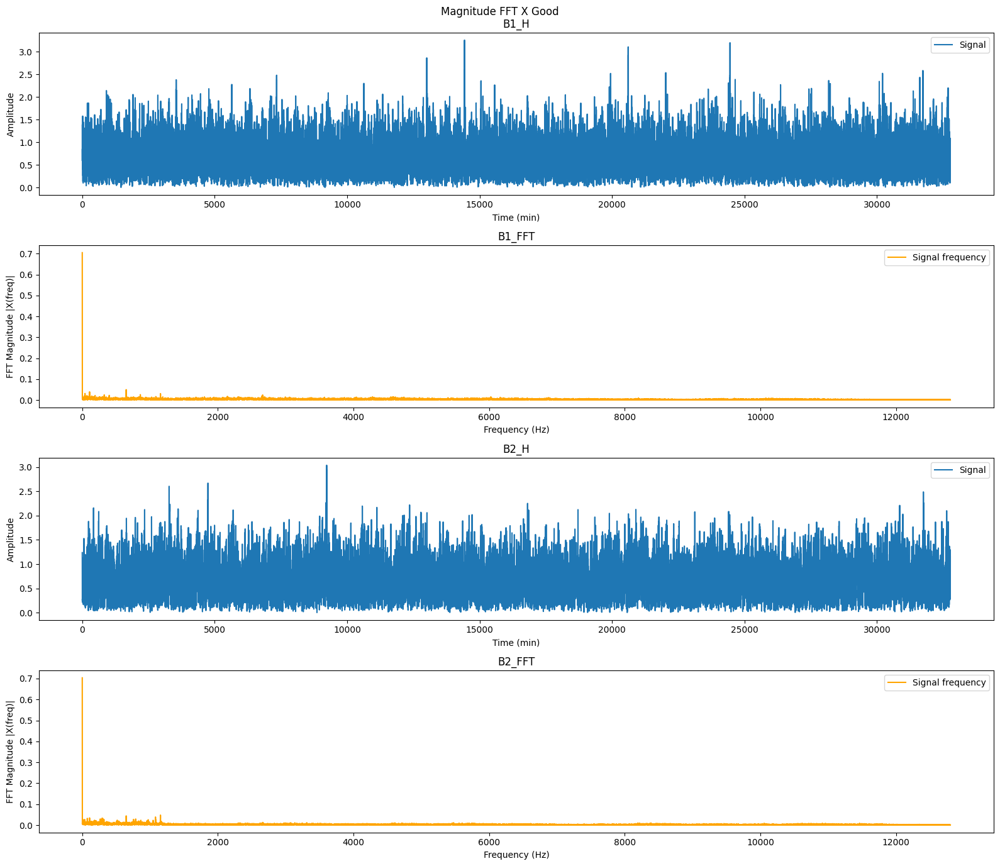

In [159]:
N = len(set1_fft)

#From the specs of XJTU-SY dataset
Fsamp = 25600

Ts = 1/Fsamp

# timestep = 10
# freq = np.fft.fftfreq(N, d=timestep)

t= np.linspace(0, (N-1)*Ts, N)
Fs= Fsamp/ N
f= np.linspace(0, (N-1)*Fs, N)

f_plot= f[0:int(N/2+1)]
set1_fft_mag= 2 * set1_fft [0:int(N/2+1)]
set1_fft_mag[0]= set1_fft_mag[0] / 2
set2_fft_mag= 2 * set2_fft [0:int(N/2+1)]
set2_fft_mag[0]= set2_fft_mag[0] / 2


fig, (ax0, ax1, ax2, ax3) = plt.subplots(figsize=(16, 14), nrows=4)
ax0.plot(h_signal_1, label='Signal')
ax0.set_title("B1_H")
ax0.set_xlabel("Time (min)")
ax0.set_ylabel("Amplitude")
ax0.legend()
ax1.plot(f_plot, set1_fft_mag, label='Signal frequency', color= 'orange')
ax1.set_title("B1_FFT")
ax1.set_xlabel("Frequency (Hz)")
ax1.set_ylabel("FFT Magnitude |X(freq)|")
ax1.legend()

ax2.plot(h_signal_2, label='Signal')
ax2.set_title("B2_H")
ax2.set_xlabel("Time (min)")
ax2.set_ylabel("Amplitude")
ax2.legend()
ax3.plot(f_plot, set2_fft_mag, label='Signal frequency', color= 'orange')
ax3.set_title("B2_FFT")
ax3.set_xlabel("Frequency (Hz)")
ax3.set_ylabel("FFT Magnitude |X(freq)|")
ax3.legend()

fig.suptitle('Magnitude FFT X Good')
fig.tight_layout()

In [160]:
set1_pure= dataset_bad.iloc[:,0]
h_signal_1 = np.abs(hilbert(set1_pure))
set2_pure= dataset_bad.iloc[:,1]
h_signal_2 = np.abs(hilbert(set2_pure))

set1_fft= np.abs(np.fft.fft(h_signal_1) /len (h_signal_1))
set2_fft= np.abs(np.fft.fft(h_signal_2) /len (h_signal_2))

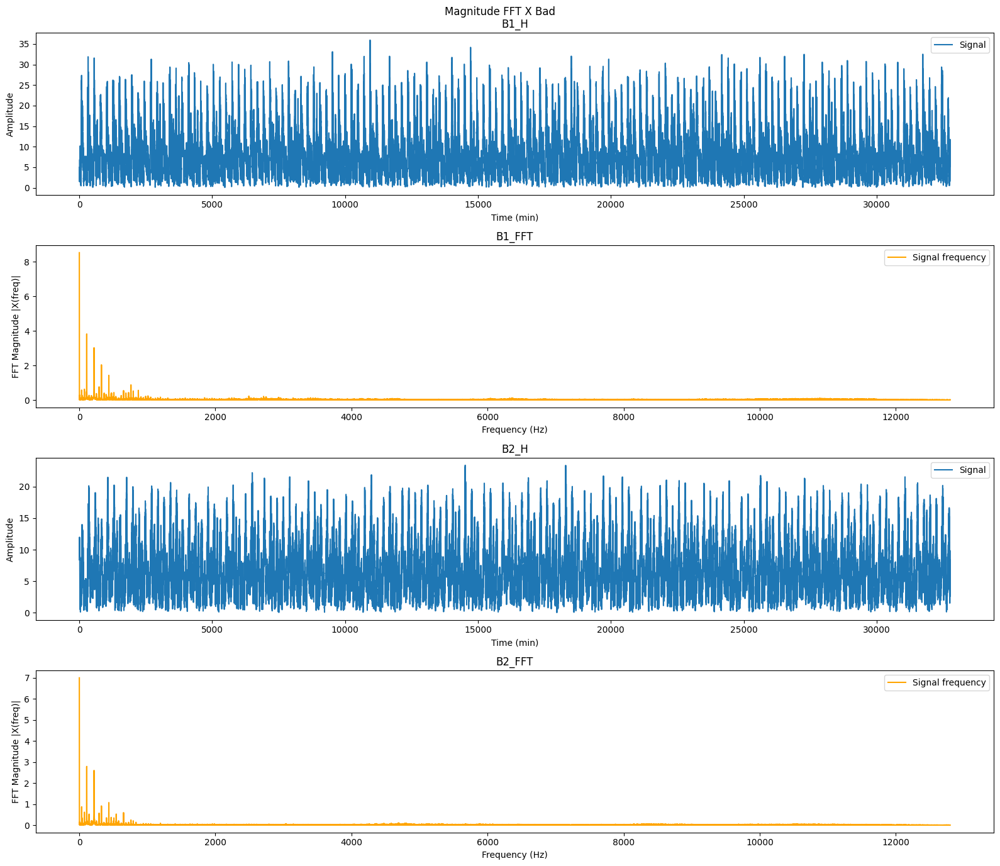

In [161]:
N = len(set1_fft)

#From the specs of XJTU-SY dataset
Fsamp = 25600

Ts = 1/Fsamp

# timestep = 10
# freq = np.fft.fftfreq(N, d=timestep)

t= np.linspace(0, (N-1)*Ts, N)
Fs= Fsamp/ N
f= np.linspace(0, (N-1)*Fs, N)

f_plot= f[0:int(N/2+1)]
set1_fft_mag= 2 * set1_fft [0:int(N/2+1)]
set1_fft_mag[0]= set1_fft_mag[0] / 2
set2_fft_mag= 2 * set2_fft [0:int(N/2+1)]
set2_fft_mag[0]= set2_fft_mag[0] / 2


fig, (ax0, ax1, ax2, ax3) = plt.subplots(figsize=(16, 14), nrows=4)
ax0.plot(h_signal_1, label='Signal')
ax0.set_title("B1_H")
ax0.set_xlabel("Time (min)")
ax0.set_ylabel("Amplitude")
ax0.legend()
ax1.plot(f_plot, set1_fft_mag, label='Signal frequency', color= 'orange')
ax1.set_title("B1_FFT")
ax1.set_xlabel("Frequency (Hz)")
ax1.set_ylabel("FFT Magnitude |X(freq)|")
ax1.legend()

ax2.plot(h_signal_2, label='Signal')
ax2.set_title("B2_H")
ax2.set_xlabel("Time (min)")
ax2.set_ylabel("Amplitude")
ax2.legend()
ax3.plot(f_plot, set2_fft_mag, label='Signal frequency', color= 'orange')
ax3.set_title("B2_FFT")
ax3.set_xlabel("Frequency (Hz)")
ax3.set_ylabel("FFT Magnitude |X(freq)|")
ax3.legend()

fig.suptitle('Magnitude FFT X Bad')
fig.tight_layout()

# Unsupervised

In [7]:
import keras
from matplotlib import pyplot as plt
import numpy as np
import gzip
%matplotlib inline
import tensorflow as tf
from keras.models import Model
from keras.optimizers import RMSprop
from keras.layers import Input,Dense,Flatten,Dropout,Reshape,Conv1D,MaxPooling1D,UpSampling1D,Conv1DTranspose,BatchNormalization,Lambda
from keras.models import Model,Sequential
from keras.callbacks import ModelCheckpoint
from keras.optimizers import Adadelta, RMSprop,SGD,Adam
from keras import regularizers
from keras import backend as K
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split

In [2]:
label_dict = {
 0: 'Low',
 1: 'Medium',
 2: 'High',
}

In [146]:
batch_size = 64
epochs = 200
inChannel = 1
x = len(set1_fft)

train_data = set1_fft.reshape(-1, 1)
test_data = set2_fft.reshape(-1, 1)

train_X,valid_X,train_ground,valid_ground = train_test_split(train_data,
                                                             train_data,
                                                             test_size=0.2)

input_sig = Input(shape = (x, inChannel))
print (input_sig)
num_classes = 3

KerasTensor(type_spec=TensorSpec(shape=(None, 20479, 1), dtype=tf.float32, name='input_21'), name='input_21', description="created by layer 'input_21'")


In [132]:
def classifier_func(x):
    return x+x*K.one_hot(K.argmax(x, axis=1), num_classes= num_classes)

In [147]:
def encoder(input_sig, num_classes):

    #encoder
    #input = 28 x 28 x 1 (wide and thin)
    #print(tf.shape(input_sig))
    conv1 = Conv1D(32, (3), activation='relu', padding='same',input_shape=(20479, 1))(input_sig) #28 x 28 x 32
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv1D(32, (3), activation='relu', padding='same')(conv1)
    conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling1D(pool_size=(2), padding= 'same')(conv1) #14 x 14 x 32
    conv2 = Conv1D(64, (3), activation='relu', padding='same')(pool1) #14 x 14 x 64
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv1D(64, (3), activation='relu', padding='same')(conv2)
    conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling1D(pool_size= (2), padding='same')(conv2) #7 x 7 x 64
    conv3 = Conv1D(128, (3), activation='relu', padding='same')(pool2) #7 x 7 x 128 (small and thick)
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv1D(128, (3), activation='relu', padding='same')(conv3)
    conv3 = BatchNormalization()(conv3)
    conv4 = Conv1D(256, (3), activation='relu', padding='same')(conv3) #7 x 7 x 256 (small and thick)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv1D(256, (3), activation='relu', padding='same')(conv4)
    conv4 = BatchNormalization()(conv4)
    den = Dense(128, activation='relu')(conv4)
    out = Dense(num_classes, activation='softmax')(den)
    return out

def decoder(out):    
    #decoder
    conv5 = Conv1D(128, (3), activation='relu', padding='same')(out) #7 x 7 x 128
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv1D(128, (3), activation='relu', padding='same')(conv5)
    conv5 = BatchNormalization()(conv5)
    conv6 = Conv1D(64, (3), activation='relu', padding='same')(conv5) #7 x 7 x 64
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv1D(64, (3), activation='relu', padding='same')(conv6)
    conv6 = BatchNormalization()(conv6)
    up1 = UpSampling1D((2))(conv6) #14 x 14 x 64
    conv7 = Conv1D(32, (3), activation='relu', padding='same')(up1) # 14 x 14 x 32
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv1D(32, (3), activation='relu', padding='same')(conv7)
    conv7 = BatchNormalization()(conv7)
    up2 = UpSampling1D((2))(conv7) # 28 x 28 x 32
    decoded = Conv1D(1, (3), activation='sigmoid', padding='same')(up2) # 28 x 28 x 1
    return decoded

In [148]:
autoencoder = Model(input_sig, decoder(encoder(input_sig, num_classes)))
autoencoder.compile(loss='mean_squared_error', optimizer = RMSprop())

In [149]:
autoencoder.summary()
autoencoder_train = autoencoder.fit(train_X, train_ground, batch_size=batch_size,epochs=epochs,verbose=1,validation_data=(valid_X, valid_ground))

Model: "model_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_21 (InputLayer)       [(None, 20479, 1)]        0         
                                                                 
 conv1d_499 (Conv1D)         (None, 20479, 32)         128       
                                                                 
 batch_normalization_468 (Ba  (None, 20479, 32)        128       
 tchNormalization)                                               
                                                                 
 conv1d_500 (Conv1D)         (None, 20479, 32)         3104      
                                                                 
 batch_normalization_469 (Ba  (None, 20479, 32)        128       
 tchNormalization)                                               
                                                                 
 max_pooling1d_78 (MaxPoolin  (None, 10240, 32)        0  

In [150]:
autoencoder.save_weights('models_autoencoder/autoencoder')

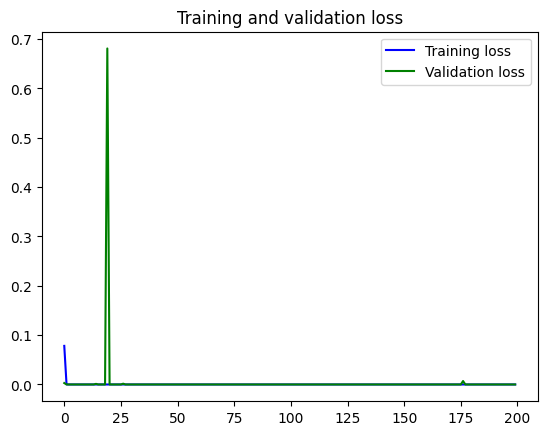

In [151]:
loss = autoencoder_train.history['loss']
val_loss = autoencoder_train.history['val_loss']
epochs = range(200)
plt.figure()
plt.plot(epochs, loss, label='Training loss', color= "blue")
plt.plot(epochs, val_loss, label='Validation loss', color= "green")
plt.title('Training and validation loss')
plt.legend()
plt.show()

In [ ]:
# # Change the labels from categorical to one-hot encoding
# train_Y_one_hot = to_categorical(train_labels)
# test_Y_one_hot = to_categorical(test_labels)

# # Display the change for category label using one-hot encoding
# print('Original label:', train_labels[0])
# print('After conversion to one-hot:', train_Y_one_hot[0])

In [110]:
# train_X,valid_X,train_label,valid_label = train_test_split(train_data,train_data,test_size=0.2,random_state=13)

In [111]:
# def fc(enco):
#     flat = Flatten()(enco)
#     den = Dense(128, activation='relu')(flat)
#     out = Dense(num_classes, activation='softmax')(den)
#     return out

In [152]:
encode = encoder(input_sig, num_classes)
full_model = Model(input_sig,encode)
full_model.summary()

Model: "model_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_21 (InputLayer)       [(None, 20479, 1)]        0         
                                                                 
 conv1d_514 (Conv1D)         (None, 20479, 32)         128       
                                                                 
 batch_normalization_482 (Ba  (None, 20479, 32)        128       
 tchNormalization)                                               
                                                                 
 conv1d_515 (Conv1D)         (None, 20479, 32)         3104      
                                                                 
 batch_normalization_483 (Ba  (None, 20479, 32)        128       
 tchNormalization)                                               
                                                                 
 max_pooling1d_80 (MaxPoolin  (None, 10240, 32)        0  

In [155]:
encode = full_model.predict(train_X)

print(label_dict)
    
neuron_class = np.zeros((num_classes))
for i in range(num_classes):
    neuron_class[i] = np.argmax(label_dict[i], axis=0)

print(neuron_class)

encode = full_model.predict(valid_X)

print (encode)

predicted = np.argmax(encode, axis=1)
for i, sample in enumerate(predicted):
    predicted[i] = neuron_class[predicted[i]]
print(neuron_class)

512/512 [==============================] - 2s 4ms/step
{0: 'Low', 1: 'Medium', 2: 'High'}
[0. 0. 0.]
128/128 [==============================] - 1s 4ms/step
[[[0.33333334 0.33333337 0.33333334]]

 [[0.33333334 0.33333337 0.33333334]]

 [[0.3333333  0.33333334 0.3333333 ]]

 ...

 [[0.33333334 0.33333337 0.33333334]]

 [[0.33333334 0.33333337 0.33333334]]

 [[0.3333333  0.33333334 0.3333333 ]]]
[0. 0. 0.]


# Supervised statistic

In [134]:
import scipy.stats as st
import statsmodels.stats.weightstats as stat

In [100]:
filename= "Bearing1_1_bootstrap.csv"
if re.search('^Bearing.*timefeature', filename):
    print ("ok")

#freq column 12:17 for B1 and 32:37
B1_mean,B1_std,B1_skew,B1_kurtosis,B1_entropy,B1_rms,B1_max,B1_p2p,B1_crest,B1_clearence,B1_shape,B1_impulse,B1_freq_band_1,B1_freq_band_2,B1_freq_band_3,B1_freq_band_4,B1_freq_band_5,B1_Event,B1_Survival_time,B2_mean,B2_std,B2_skew,B2_kurtosis,B2_entropy,B2_rms,B2_max,B2_p2p,B2_crest,B2_clearence,B2_shape,B2_impulse,B2_freq_band_1,B2_freq_band_2,B2_freq_band_3,B2_freq_band_4,B2_freq_band_5,B2_Event,B2_Survival_time

In [110]:
dataset_path = "./data/XJTU-SY/csv/"
set_analytic= pd.DataFrame()
set_covariates= pd.DataFrame()

for filename in os.listdir(dataset_path):

    i= 0

    if re.search('^Bearing.*timefeature', filename):

        datafile = pd.read_csv(os.path.join(dataset_path, filename))
        set_analytic_aux= datafile.iloc[:, 12: 17]
        set_cov_aux= datafile.iloc[:, 0: 12]
        set_analytic= pd.concat([set_analytic, set_analytic_aux], axis=1)
        set_covariates= pd.concat([set_covariates, set_cov_aux], axis=1)
        set_cov_aux= datafile.iloc[:, 17: 19]     
        set_covariates= pd.concat([set_covariates, set_cov_aux], axis=1)   

        set_analytic_aux= datafile.iloc[:, 31: 36]
        set_cov_aux= datafile.iloc[:, 19: 31]
        set_analytic= pd.concat([set_analytic, set_analytic_aux], axis=1)
        set_covariates= pd.concat([set_covariates, set_cov_aux], axis=1)
        set_cov_aux= datafile.iloc[:, 36: 38]     
        set_covariates= pd.concat([set_covariates, set_cov_aux], axis=1)   



# check_nan = [set_analytic.isnull().values.any(), set_covariates.isnull().values.any()]
# print(check_nan)

set_analytic.to_csv(dataset_path + 'analytic.csv', index= False)
set_covariates.to_csv(dataset_path + 'covariates.csv', index= False)

In [123]:
set1_good= set_analytic.iloc[0:20,:]

set1_middle1= set_analytic.iloc[20:40,:]

set1_middle2= set_analytic.iloc[40:60,:]

set1_bad= set_analytic.iloc[104:124,:]

check_nan = [set1_middle2.isnull().values.any(), set1_bad.isnull().values.any()]
print(check_nan)

[True, True]


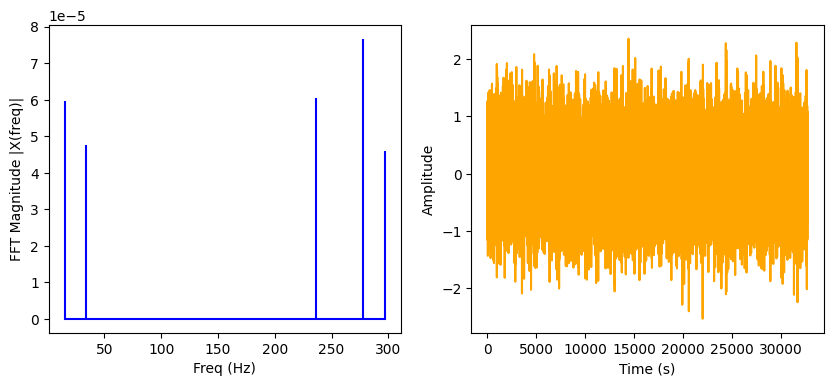

In [124]:
dataset_path = "./data/XJTU-SY/35Hz12kN/Bearing1_1/"
raw_data_g = pd.read_csv(dataset_path + '1.csv')

fft_x_g= set1_good.iloc[0:1,0:5].values
fft_x_g = np.squeeze(fft_x_g)

freq= [15, 34, 236, 278, 297]

ts = len(np.squeeze(raw_data_g.iloc[:,0:1].values))
t = np.arange(0,ts,1)

plt.figure(figsize = (10, 4))
plt.subplot(121)

plt.stem(freq, fft_x_g, 'b', markerfmt=" ", basefmt="-b")
plt.xlabel('Freq (Hz)')
plt.ylabel('FFT Magnitude |X(freq)|')
#plt.ylim(0, 0.0005)

plt.subplot(122)
plt.plot(t, np.squeeze(raw_data_g.iloc[:,0:1].values), 'orange')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
#plt.suptitle('Good bearing')
plt.show()

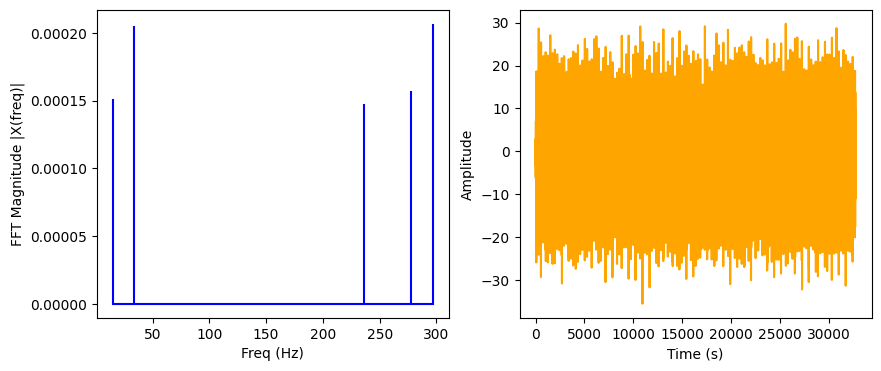

In [125]:
dataset_path = "./data/XJTU-SY/35Hz12kN/Bearing1_1/"
raw_data_g = pd.read_csv(dataset_path + '123.csv')

fft_x_g= set1_bad.iloc[0:1,0:5].values
fft_x_g = np.squeeze(fft_x_g)

freq= [15, 34, 236, 278, 297]

ts = len(np.squeeze(raw_data_g.iloc[:,0:1].values))
t = np.arange(0,ts,1)

plt.figure(figsize = (10, 4))
plt.subplot(121)

plt.stem(freq, fft_x_g, 'b', markerfmt=" ", basefmt="-b")
plt.xlabel('Freq (Hz)')
plt.ylabel('FFT Magnitude |X(freq)|')
#plt.ylim(0, 0.0005)

plt.subplot(122)
plt.plot(t, np.squeeze(raw_data_g.iloc[:,0:1].values), 'orange')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
#plt.suptitle('Bad bearing')
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [smoothline] >Smoothing by interpolation..
[distfit] >INFO> [norm      ] [0.00 sec] [RSS: 9.92174e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 1.31302e+09] [loc=0.000 scale=0.000]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 1.31302e+09] [loc=-512.000 scale=512.000]
[distfit] >INFO> [dweibull  ] [0.02 sec] [RSS: 9.43618e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [t         ] [0.10 sec] [RSS: 9.76946e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [genextreme] [0.15 sec] [RSS: 1.47014e+09] [loc=0.000 scale=0.000]
[distfit] >INFO> [gamma     ] [0.12 sec] [RSS: 1.4262e+09] [loc=0.000 scale=0.000]
[distfit] >INFO> [lognorm   ] [0.06 sec] [RSS: 1.51284e+09] [loc=0.000 scale=0.000]
[distfit] >INFO> [beta      ] [0.27 sec] [RSS: 1.32061e+09]

(<Figure size 2500x1200 with 1 Axes>,
 <AxesSubplot:title={'center':'\ndweibull(c=1.08876, loc=5.56547e-05, scale=1.49591e-05)'}, xlabel='Number', ylabel='Tip value'>)

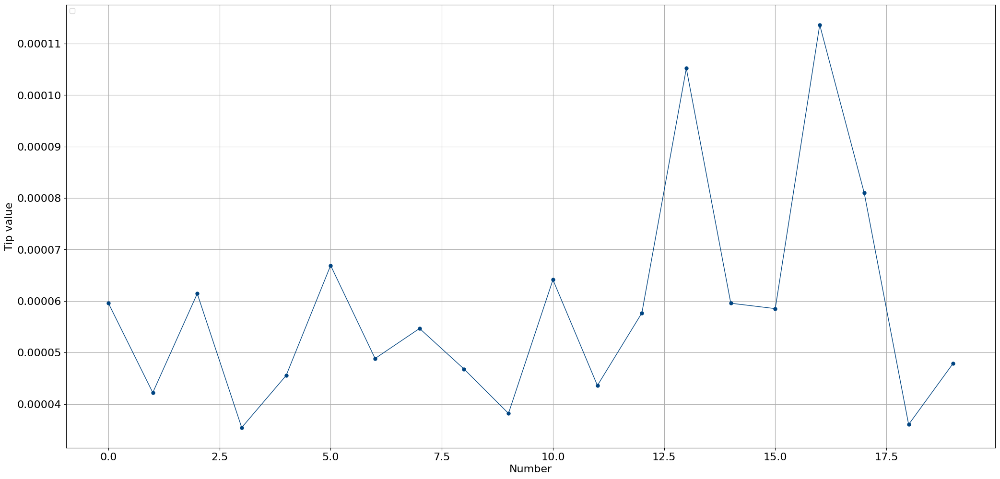

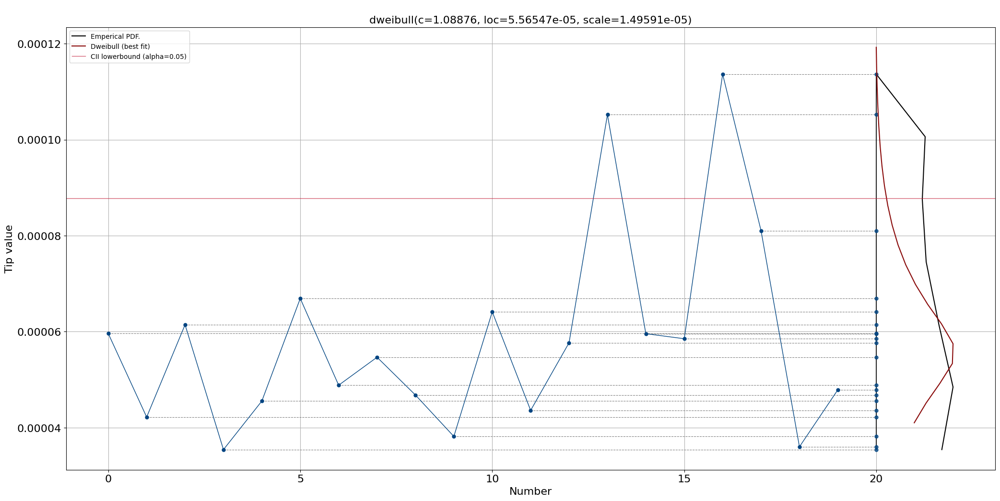

In [127]:
# Initialize
dfit = distfit(smooth=3, bound='up')
# Import
df = set1_good
# Make line plot without any fitting
dfit.lineplot(df["B1_freq_band_1"], xlabel='Number', ylabel='Tip value', grid=True, line_properties={'marker':'.'})

# Fit
dfit.fit_transform(df["B1_freq_band_1"])
# Create line plot but now with the distribution
dfit.lineplot(df["B1_freq_band_1"], xlabel='Number', ylabel='Tip value', grid=True, line_properties={'marker':'.'}, projection=True)

[distfit] >INFO> Ploting Summary.


(<Figure size 2000x1000 with 1 Axes>,
 <AxesSubplot:title={'center':'Dweibull (best fit)'}, xlabel='Probability Density Function (PDF)', ylabel='RSS (goodness of fit test)'>)

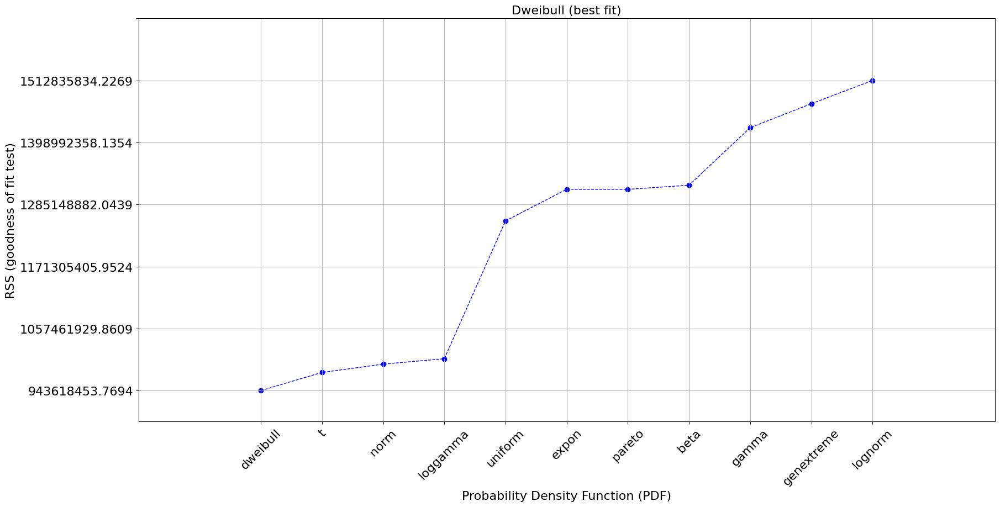

In [128]:
dfit.plot_summary()

[distfit] >INFO> Ploting Summary.


(<Figure size 2000x1000 with 1 Axes>,
 <AxesSubplot:title={'center':'Dweibull (best fit)'}, xlabel='Probability Density Function (PDF)', ylabel='RSS (goodness of fit test)'>)

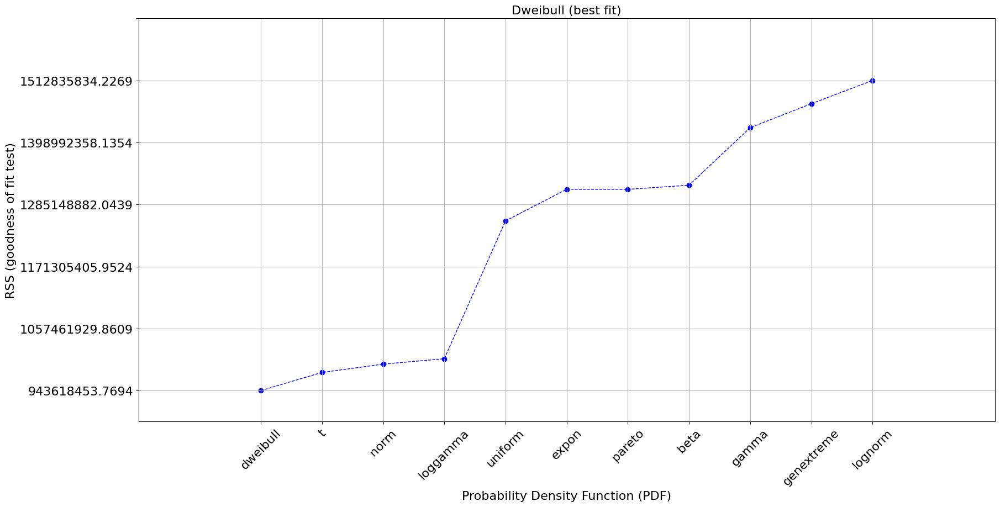

In [129]:
dfit.plot_summary()

In [23]:
# stat.ttest_ind(x1, x2, alternative='two-sided', usevar='pooled', weights=(None, None), value=0)
t_stat = stat.ttest_ind(set1_good["B1_x_freq_band_1"].values, set1_good["B1_x_freq_band_1"].values)
print (t_stat)
t_stat = stat.ttest_ind(set1_good["B1_x_freq_band_1"].values, set1_middle1["B1_x_freq_band_1"].values)
print (t_stat)
t_stat = stat.ttest_ind(set1_good["B1_x_freq_band_1"].values, set1_middle2["B1_x_freq_band_1"].values)
print (t_stat)
t_stat = stat.ttest_ind(set1_good["B1_x_freq_band_1"].values, set1_bad["B1_x_freq_band_1"].values)
print (t_stat)

(0.0, 1.0, 70.0)
(0.008872068286098803, 0.9929464433371961, 70.0)
(-9.77877663898837, 1.0043374369551076e-14, 70.0)
(-12.233599196172678, 4.736586342305706e-19, 70.0)


In [18]:
# stat.ztest(x1, x2=None, value=0, alternative='two-sided', usevar='pooled', ddof=1.0) 0.0003291
z_stat = stat.ztest(set1_good["B1_x_freq_band_1"], x2=None, value= 5.68985, alternative='two-sided')
print (z_stat)

(-8026574.479903986, 0.0)


In [86]:
D2 = entropy(set1_good["B1_x_freq_band_1"].values, set1_bad["B1_x_freq_band_1"].values)
print (D2)
D1 = entropy(set1_good["B1_x_freq_band_1"].values, set1_middle2["B1_x_freq_band_1"].values)
print (D1)
D3 = entropy(set1_good["B1_x_freq_band_1"].values, set1_good["B1_x_freq_band_1"].values)
print (D3)

0.018558354072605268
0.014233924800472461
0.0


In [92]:
#bad= np.zeros((set1_bad["B1_x_freq_band_1"].shape), dtype= float)
bad = set1_bad["B1_x_freq_band_1"].values
bad[:]= set1_good["B1_x_freq_band_1"].values +200
chi= st.chisquare(set1_good["B1_x_freq_band_1"].values, (np.sum(set1_good["B1_x_freq_band_1"].values)/ np.sum(bad) * bad))
print (chi)

Power_divergenceResult(statistic=0.0003451305899528688, pvalue=1.0)


In [36]:
mean1, std1 = set1_good.mean(), set1_good.std()
mean2, std2 = set1_bad.mean(), set1_bad.std()
test_statistic_good = (np.mean(set1_good) - mean1) / (std1 / np.sqrt(len(set1_good)))
test_statistic_bad = (np.mean(set1_bad) - mean1) / (std1 / np.sqrt(len(set1_bad)))
#Select the distribution in "gamma"
p_value_good = st.gamma.sf(abs(test_statistic_good), len(set1_good)-1)
p_value_bad = st.gamma.sf(abs(test_statistic_bad), len(set1_bad)-1)
print (np.std(set1_good.values))
print (np.std(set1_bad.values))

4.350198296114099e-05
7.366414757809348e-05


In [207]:
def evaluator_KL(x, window):

    lenght= int((len(x) - x.iloc[:,0:1].isna().sum().values[0]) /window)
    len_col= len(x.columns)
    res = np.zeros((len_col,lenght - 1), dtype= float) #2156/36
    i = 0
    j = 0
    index_s = 0
    for x_label, __ in x.items():
        for index_s in range (window, len(x), window):
            index_e= index_s + window
            if index_e <= len(x) and not x [index_s : index_e].isnull().values.any():
                temp_window1 = x [0 : window]
            else:
                break
            temp_window2 = x [index_s : index_e]
            res [j][i] = entropy(temp_window1[x_label].values, temp_window2[x_label].values)
            i += 1
        i = 0
        j += 1

    return res

def evaluator_Ttest(x, window):
 
    lenght= int((len(x) - x.iloc[:,0:1].isna().sum().values[0]) /window)
    len_col= len(x.columns)
    res = np.zeros((len_col,lenght - 1), dtype= float) #2156/36
    i = 0
    j = 0
    index_s = 0
    for x_label, __ in x.items():
        for index_s in range (window, len(x), window):
            index_e= index_s + window
            if index_e <= len(x) and not x [index_s : index_e].isnull().values.any():
                temp_window1 = x [0 : window]
            else:
                break
            temp_window2 = x [index_s : index_e]

            res [j][i] = stat.ttest_ind(temp_window1[x_label].values, temp_window2[x_label].values)[1]
            i += 1
        i = 0
        j += 1

    return res

def evaluator_Chi(x, window):

    lenght= int((len(x) - x.iloc[:,0:1].isna().sum().values[0]) /window)
    len_col= len(x.columns)
    res = np.zeros((len_col,lenght - 1), dtype= float) #2156/36
    i = 0
    j = 0
    index_s = 0
    for x_label, __ in x.items():
        for index_s in range (window, len(x), window):
            index_e= index_s + window
            if index_e <= len(x) and not x [index_s : index_e].isnull().values.any():
                temp_window1 = x [0 : window]
            else:
                break
            temp_window2 = x [index_s : index_e]
            res [j][i] = st.chisquare(temp_window1[x_label].values, np.sum(temp_window1[x_label].values)/ np.sum(temp_window2[x_label].values) * temp_window2[x_label].values)[0]
            i += 1
        i = 0
        j += 1

    return res

def evaluator_SD(x, window):

    lenght= int((len(x) - x.iloc[:,0:1].isna().sum().values[0]) /window)
    len_col= len(x.columns)
    res = np.zeros((len_col,lenght - 1), dtype= float) #2156/36
    i = 0
    j = 0
    index_s = 0
    for x_label, __ in x.items():
        for index_s in range (window, len(x), window):
            index_e= index_s + window
            if index_e > len(x) or x [index_s : index_e].isnull().values.any():
                break
            temp_window = x [index_s : index_e]

            res [j][i] = np.std(temp_window[x_label].values)
            i += 1
        i = 0
        j += 1

    return res

In [208]:
def evaluator_breakpoint(kl, sd, t, chi):
    i= 0
    j= 0
    w= 0
    m= 0
    q= 0
    bins = 5
    data= 3
    thresholds_kl = np.zeros((bins, data), dtype= float)
    thresholds_sd = np.zeros((bins, data), dtype= float)
    thresholds_t = np.zeros((bins, data), dtype= float)
    thresholds_chi = np.zeros((bins, data), dtype= float)


    for bin in kl:

        break_in= int(len(bin)* 40 /100)
        for step in bin:

            if i <= break_in:
                if bin[i]> thresholds_kl [j][0] or i== 0:
                    thresholds_kl [j][0]= bin[i]
                    thresholds_kl [j][1]= bin[i] + (bin[i]/100 * 4)
                w= i+1

                if i> 0 and bin[i]>= thresholds_kl [j][0]:
                    thresholds_kl [j][2]= 0                    

                for step_2 in bin[i+1:]:
                    if step_2 > thresholds_kl [j][1]:
                        m= bin[w]-bin[w-1]
                        q= bin[w-1]
                        # thresholds_kl [j][2], =  np.where(np.isclose(bin, step_2))
                        thresholds_kl [j][2] =  (thresholds_kl [j][1]/m) - (q/m) + (w -1)
                        break
                    w += 1
            # elif bin[i]> bin[i-1] - (bin[i-1]/100 * 4):

            #     if bin[i]> thresholds_kl [j][0]: 
            #         thresholds_kl [j][0]= bin[i]
            #         thresholds_kl [j][1]= bin[i] + (bin[i]/100 * 4)
            #         thresholds_kl [j][2]= 0
                
            #     w= i+1
            #     for step_2 in bin[i+1:]:
            #         if step_2 > thresholds_kl [j][1]:
            #             m= bin[w]-bin[w-1]
            #             q= bin[w-1]
            #             thresholds_kl [j][2] =  (thresholds_kl [j][1]/m) - (q/m) + (w -1)
            #             # thresholds_kl [j][2], = np.where(np.isclose(bin, step_2))
            #             break
            #         w += 1
            else:
                break

            i+= 1
        i= 0
        j+= 1

    i= 0
    j= 0

    for bin in sd:

        break_in= int(len(bin)* 40 /100)
        for step in bin:

            if  i <= break_in:
                if bin[i]> thresholds_sd [j][0] or i== 0:
                    thresholds_sd [j][0]= bin[i]
                    thresholds_sd [j][1]= bin[i] + (bin[i]/100 * 4)
                w= i+1

                if i> 0 and bin[i]>= thresholds_sd [j][0]:
                    thresholds_sd [j][2]= 0     

                for step_2 in bin[i+1:]:
                    if step_2 > thresholds_sd [j][1]:
                        m= bin[w]-bin[w-1]
                        q= bin[w-1]
                        # thresholds_kl [j][2], =  np.where(np.isclose(bin, step_2))
                        thresholds_sd [j][2] =  (thresholds_sd [j][1]/m) - (q/m) + (w -1)
                        break
                    w += 1
            # elif bin[i]> bin[i-1] - (bin[i-1]/100 * 4):

            #     if bin[i]> thresholds_sd [j][0] or i== 0:
            #         thresholds_sd [j][0]= bin[i]
            #         thresholds_sd [j][1]= bin[i] + (bin[i]/100 * 4)
            #         thresholds_sd [j][2]= 0

            #     w= i+1
            #     for step_2 in bin[i+1:]:
            #         if step_2 > thresholds_sd [j][1]:
            #             m= bin[w]-bin[w-1]
            #             q= bin[w-1]
            #             thresholds_sd [j][2] =  (thresholds_sd [j][1]/m) - (q/m) + (w -1)
            #             # thresholds_kl [j][2], = np.where(np.isclose(bin, step_2))
            #             break
            #         w += 1
            else:
                break

            i+= 1
        i= 0
        j+= 1

    i= 0
    j= 0
    count= 0
    t_threshold= - 1e-20 
    ground_level= 0

    for bin in t:
        for step in bin:
            if i == 0:
                i+= 1
                continue

            if count== data - 1:
                break

            ground_level= min(bin) + (min(bin) /100 * 4)

            x= list(range (0, len(bin), 1))
            y= bin
            dydx= np.diff(y)/np.diff(x)

            w= 1
            for val in dydx:
                if val < t_threshold and bin[i] < ground_level and count< 3 and w> 1:
                    thresholds_t [j][count]= w
                    count+= 1
                w += 1

            i+= 1
        count= 0    
        i= 0
        j+= 1

    i= 0
    j= 0
    count= 0
    t_threshold= - 1e-20 
    ground_level= 0

    for bin in chi:
        for step in bin:
            if i == 0:
                i+= 1
                continue

            if count== data - 1:
                break

            ground_level= min(bin) + (min(bin) /100 * 4)

            x= list(range (0, len(bin), 1))
            y= bin
            dydx= np.diff(y)/np.diff(x)

            w= 1
            for val in dydx:
                if val < t_threshold and bin[i] < ground_level and count< 3 and w> 1:
                    thresholds_chi [j][count]= w
                    count+= 1
                w += 1

            i+= 1
        count= 0    
        i= 0
        j+= 1

    return thresholds_kl, thresholds_sd, thresholds_t, thresholds_chi

In [231]:
window= 10
total_bearings= 40
average_offset= 2
#break_in_offset= int(400/window) - 1
break_in_offset= 0
#minutes= window *10
minutes= window
scale_multiplier= 15
eval_KL= []
eval_t= []
eval_SD= []
eval_chi= []
event_kl= []
event_sd= []
event_t= []
event_chi= []
         

for b_num in range (1, 41, 1):

    set= set_analytic[["B{}_freq_band_1".format(b_num), "B{}_freq_band_2".format(b_num), "B{}_freq_band_3".format(b_num), "B{}_freq_band_4".format(b_num), "B{}_freq_band_5".format(b_num)]]   
    eval_KL.append(evaluator_KL(set, window))
    eval_SD.append(evaluator_SD(set, window))
    eval_t.append(evaluator_Ttest(set, window))
    eval_chi.append(evaluator_Chi(set, window))

i= 0
for set_KL in eval_KL:
    temp_kl, temp_sd, temp_t, temp_chi= evaluator_breakpoint(set_KL, eval_SD[i], eval_t[i], eval_chi[i])
    event_kl.append(temp_kl)
    event_sd.append(temp_sd)
    event_t.append(temp_t)
    event_chi.append(temp_chi)
    i += 1

In [232]:
print (len (event_kl))
print (len (event_kl[0]))
print (len (event_kl[0][0]))
print (event_kl[0][0][0])
#print (event_kl)

print (len (eval_KL))
print (len (eval_KL[0]))
print (len (eval_KL[38][0]))
print (eval_KL[0][0][0])
print(len(set_analytic))

40
5
3
0.10034386362279694
40
5
4
0.08359514315508015
162


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

ValueError: Axis limits cannot be NaN or Inf

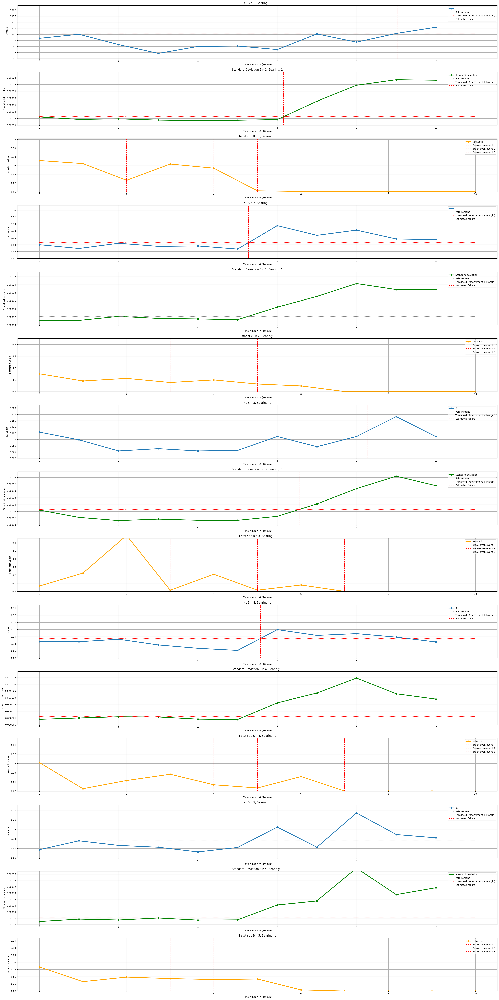

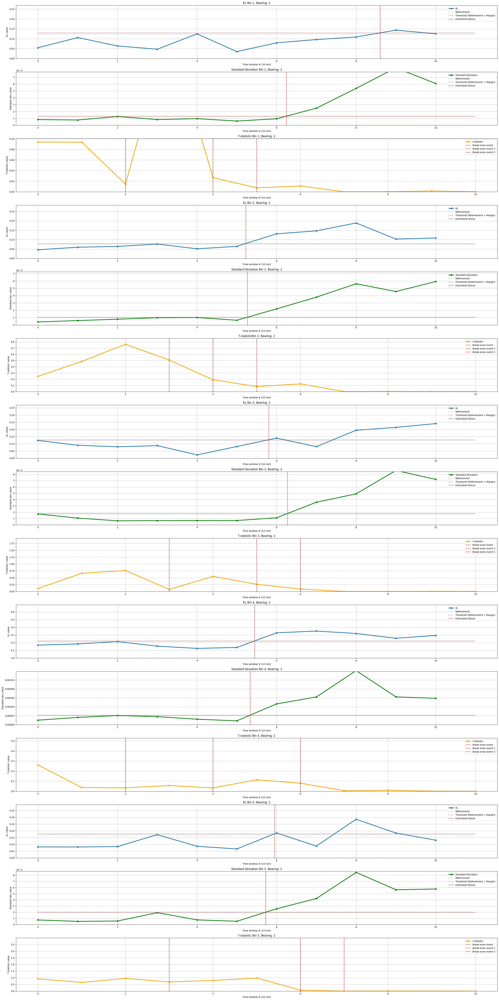

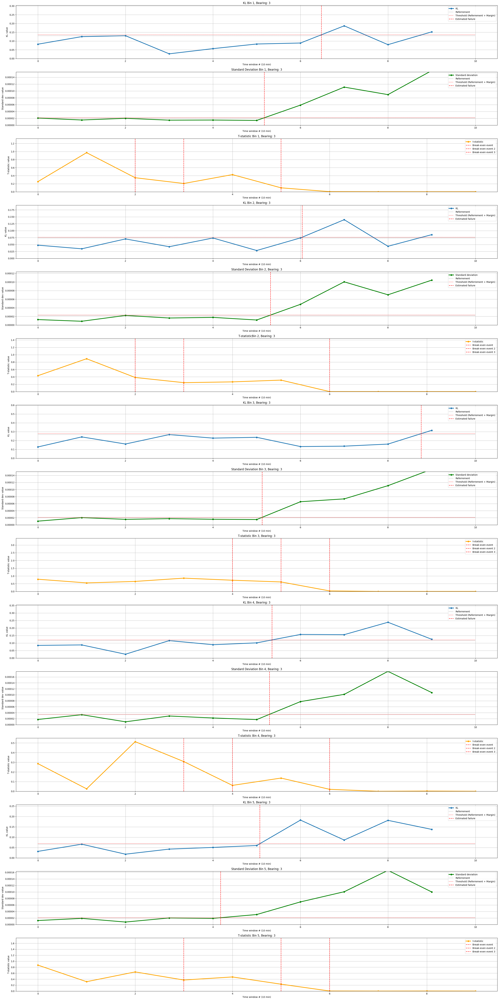

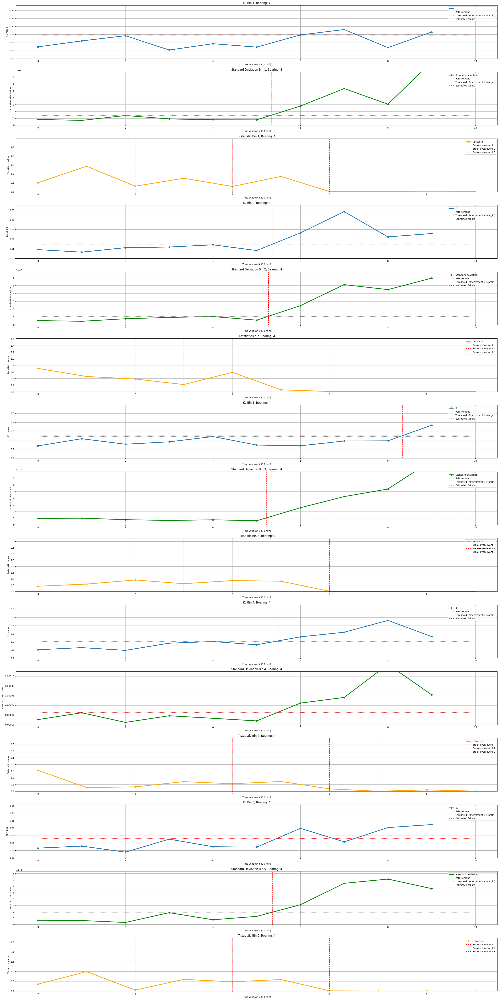

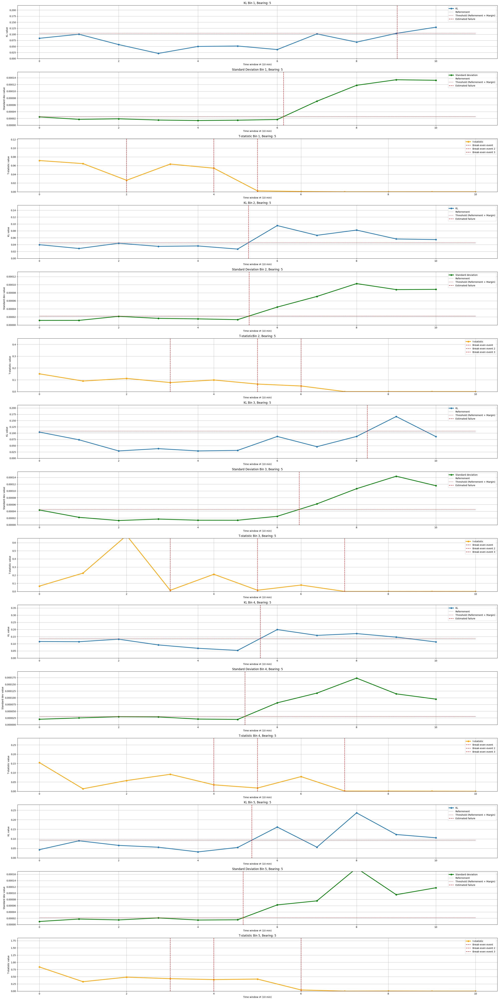

...

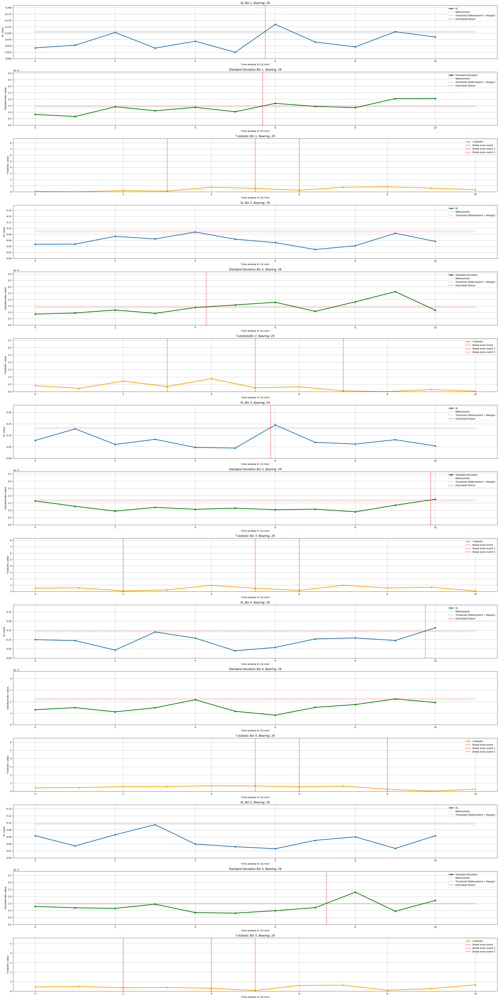

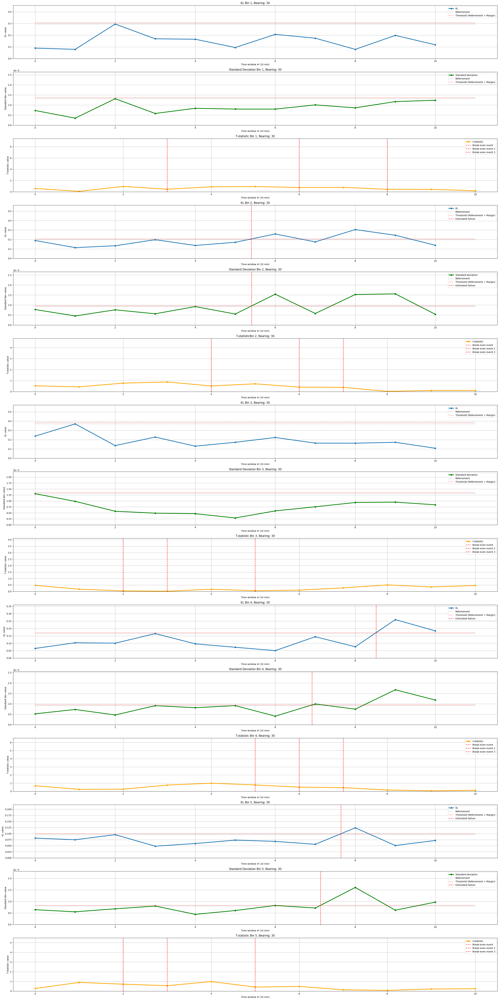

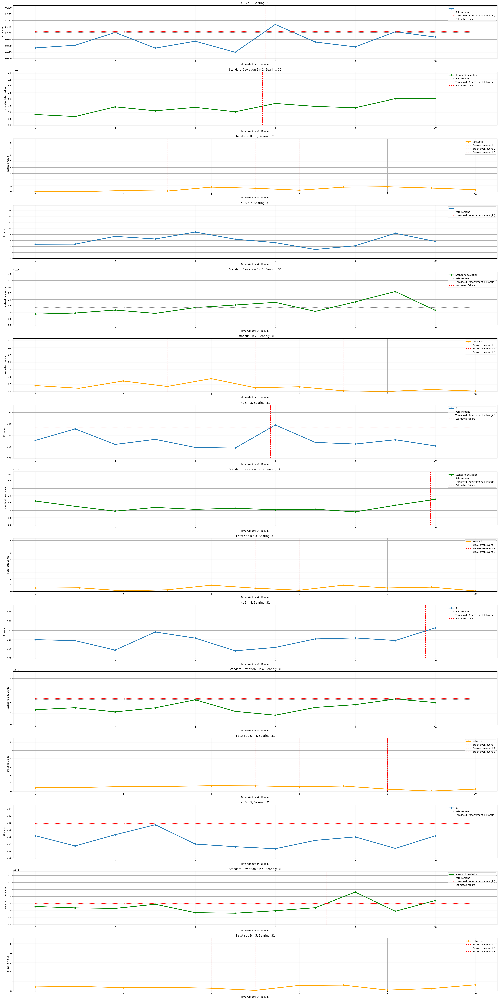

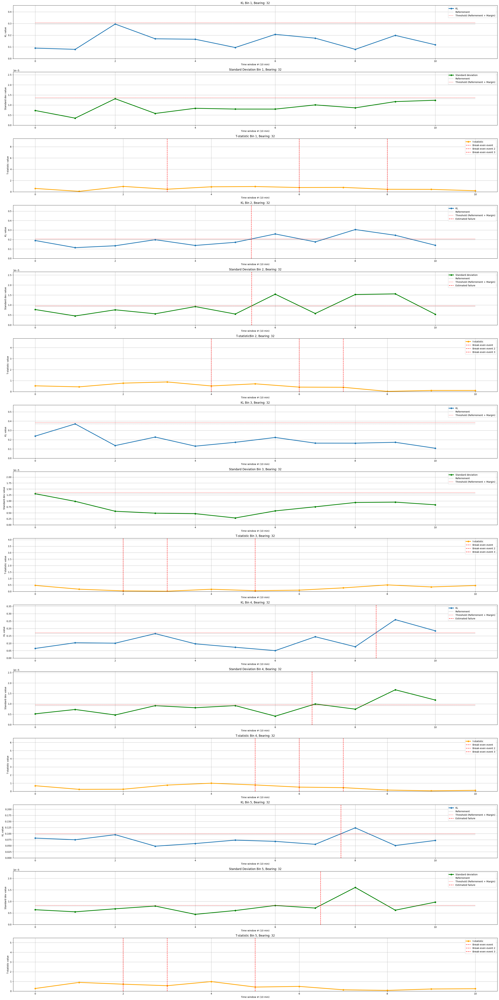

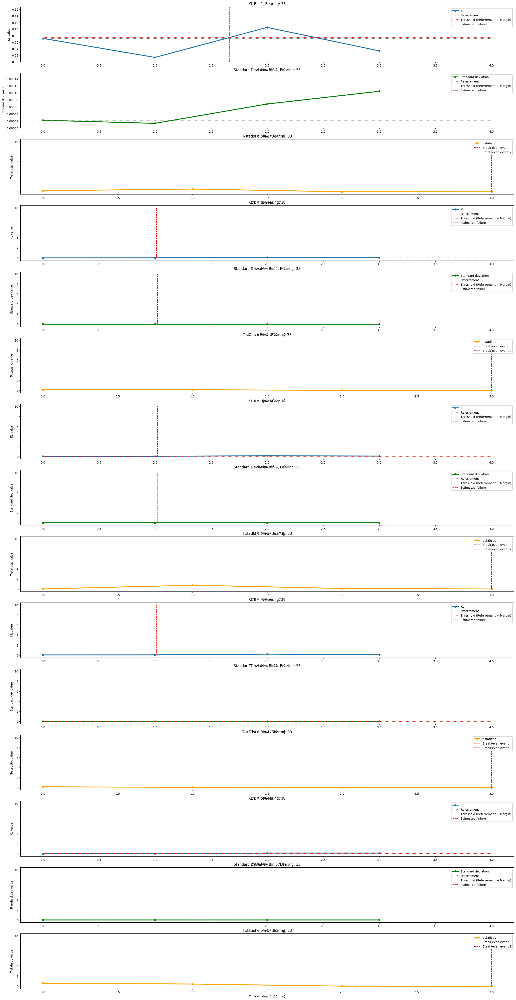

In [233]:
#general plotting

i = 0
b_num = 1

for bearing in eval_KL:
    max_x= len(bearing[0]) - 1
    max_y= 10

    fig, (ax0, ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9, ax10, ax11, ax12, ax13, ax14) = plt.subplots(figsize=(30, 60), nrows=15)
    ax0.plot(bearing[0][break_in_offset:], label='KL', marker='o', linewidth=3)
    ax0.set_title("KL Bin 1, Bearing: {}".format(b_num))
    ax0.set_xlabel("Time window # ({} min)".format(minutes))
    ax0.set_ylabel("KL value")
    ax0.hlines(event_kl[i][0][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax0.hlines(event_kl[i][0][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_kl[i][0][2]> 0):
        ax0.vlines(event_kl[i][0][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax0.legend()
    ax1.plot(eval_SD[i][0][break_in_offset:], label='Standard deviation', color= 'green', marker='o', linewidth=3)
    ax1.set_title("Standard Deviation Bin 1, Bearing: {}".format(b_num))
    ax1.set_xlabel("Time window # ({} min)".format(minutes))
    ax1.set_ylabel("Standard dev value")
    ax1.hlines(event_sd[i][0][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax1.hlines(event_sd[i][0][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_sd[i][0][2]> 0):
        ax1.vlines(event_sd[i][0][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax1.legend()
    ax2.plot(eval_t[i][0][break_in_offset:], label='t-statistic', color= 'orange', marker='o', linewidth=3)
    ax2.set_title("T-statistic Bin 1, Bearing: {}".format(b_num))
    ax2.set_xlabel("Time window # ({} min)".format(minutes))
    ax2.set_ylabel("T-statistic value")
    if (event_t[i][0][0]> 0):
        ax2.vlines(event_t[i][0][0], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event")
        if (event_t[i][0][1]> 0):
            ax2.vlines(event_t[i][0][1], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 2")
            if (event_t[i][0][2]> 0):
                ax2.vlines(event_t[i][0][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 3")
    ax2.legend()

    ax3.plot(bearing[1][break_in_offset:], label='KL', marker='o', linewidth=3)
    ax3.set_title("KL Bin 2, Bearing: {}".format(b_num))
    ax3.set_xlabel("Time window # ({} min)".format(minutes))
    ax3.set_ylabel("KL value")
    ax3.hlines(event_kl[i][1][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax3.hlines(event_kl[i][1][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_kl[i][1][2]> 0):
        ax3.vlines(event_kl[i][1][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax3.legend()
    ax4.plot(eval_SD[i][1][break_in_offset:], label='Standard deviation', color= 'green', marker='o', linewidth=3)
    ax4.set_title("Standard Deviation Bin 2, Bearing: {}".format(b_num))
    ax4.set_xlabel("Time window # ({} min)".format(minutes))
    ax4.set_ylabel("Standard dev value")
    ax4.hlines(event_sd[i][1][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax4.hlines(event_sd[i][1][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_sd[i][1][2]> 0):
        ax4.vlines(event_sd[i][1][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax4.legend()
    ax5.plot(eval_t[i][1][break_in_offset:], label='t-statistic', color= 'orange', marker='o', linewidth=3)
    ax5.set_title("T-statisticBin 2, Bearing: {}".format(b_num))
    ax5.set_xlabel("Time window # ({} min)".format(minutes))
    ax5.set_ylabel("T-statistic value")
    if (event_t[i][1][0]> 0):
        ax5.vlines(event_t[i][1][0], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event")
        if (event_t[i][1][1]> 0):
            ax5.vlines(event_t[i][1][1], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 2")
            if (event_t[i][1][2]> 0):
                ax5.vlines(event_t[i][1][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 3")
    ax5.legend()


    ax6.plot(bearing[2][break_in_offset:], label='KL', marker='o', linewidth=3)
    ax6.set_title("KL Bin 3, Bearing: {}".format(b_num))
    ax6.set_xlabel("Time window # ({} min)".format(minutes))
    ax6.set_ylabel("KL value")
    ax6.hlines(event_kl[i][2][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax6.hlines(event_kl[i][2][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_kl[i][2][2]> 0):
        ax6.vlines(event_kl[i][2][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax6.legend()
    ax7.plot(eval_SD[i][2][break_in_offset:], label='Standard deviation', color= 'green', marker='o', linewidth=3)
    ax7.set_title("Standard Deviation Bin 3, Bearing: {}".format(b_num))
    ax7.set_xlabel("Time window # ({} min)".format(minutes))
    ax7.set_ylabel("Standard dev value")
    ax7.hlines(event_sd[i][2][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax7.hlines(event_sd[i][2][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_sd[i][2][2]> 0):
        ax7.vlines(event_sd[i][2][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax7.legend()
    ax8.plot(eval_t[i][2][break_in_offset:], label='t-statistic', color= 'orange', marker='o', linewidth=3)
    ax8.set_title("T-statistic Bin 3, Bearing: {}".format(b_num))
    ax8.set_xlabel("Time window # ({} min)".format(minutes))
    ax8.set_ylabel("T-statistic value")
    if (event_t[i][2][0]> 0):
        ax8.vlines(event_t[i][2][0], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event")
        if (event_t[i][2][1]> 0):
            ax8.vlines(event_t[i][2][1], linestyles= "dashed", ymin= 0 , ymax= max_y, color="red", label= "Break-even event 2")
            if (event_t[i][2][2]> 0):
                ax8.vlines(event_t[i][2][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 3")
    ax8.legend()

    ax9.plot(bearing[3][break_in_offset:], label='KL', marker='o', linewidth=3)
    ax9.set_title("KL Bin 4, Bearing: {}".format(b_num))
    ax9.set_xlabel("Time window # ({} min)".format(minutes))
    ax9.set_ylabel("KL value")
    ax9.hlines(event_kl[i][3][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax9.hlines(event_kl[i][3][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_kl[i][3][2]> 0):
        ax9.vlines(event_kl[i][3][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax9.legend()
    ax10.plot(eval_SD[i][3][break_in_offset:], label='Standard deviation', color= 'green', marker='o', linewidth=3)
    ax10.set_title("Standard Deviation Bin 4, Bearing: {}".format(b_num))
    ax10.set_xlabel("Time window # ({} min)".format(minutes))
    ax10.set_ylabel("Standard dev value")
    ax10.hlines(event_sd[i][3][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax10.hlines(event_sd[i][3][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_sd[i][3][2]> 0):
        ax10.vlines(event_sd[i][3][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax11.legend()
    ax11.plot(eval_t[i][3][break_in_offset:], label='t-statistic', color= 'orange', marker='o', linewidth=3)
    ax11.set_title("T-statistic Bin 4, Bearing: {}".format(b_num))
    ax11.set_xlabel("Time window # ({} min)".format(minutes))
    ax11.set_ylabel("T-statistic value")
    if (event_t[i][3][0]> 0):
        ax11.vlines(event_t[i][3][0], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event")
        if (event_t[i][3][1]> 0):
            ax11.vlines(event_t[i][3][1], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 2")
            if (event_t[i][3][2]> 0):
                ax11.vlines(event_t[i][3][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 3")
    ax11.legend()


    ax12.plot(bearing[4][break_in_offset:], label='KL', marker='o', linewidth=3)
    ax12.set_title("KL Bin 5, Bearing: {}".format(b_num))
    ax12.set_xlabel("Time window # ({} min)".format(minutes))
    ax12.set_ylabel("KL value")
    ax12.hlines(event_kl[i][4][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax12.hlines(event_kl[i][4][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_kl[i][4][2]> 0):
        ax12.vlines(event_kl[i][4][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax12.legend()
    ax13.plot(eval_SD[i][4][break_in_offset:], label='Standard deviation', color= 'green', marker='o', linewidth=3)
    ax13.set_title("Standard Deviation Bin 5, Bearing: {}".format(b_num))
    ax13.set_xlabel("Time window # ({} min)".format(minutes))
    ax13.set_ylabel("Standard dev value")
    ax13.hlines(event_sd[i][4][0], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "gray", label= "Referrement")
    ax13.hlines(event_sd[i][4][1], linestyles= "dotted", xmin= 0 , xmax= max_x, color= "red", label= "Threshold (Referrement + Margin)")
    if (event_sd[i][4][2]> 0):
        ax13.vlines(event_sd[i][4][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Estimated failure")
    ax13.legend()
    ax14.plot(eval_t[i][4][break_in_offset:], label='t-statistic', color= 'orange', marker='o', linewidth=3)
    ax14.set_title("T-statistic Bin 5, Bearing: {}".format(b_num))
    ax14.set_xlabel("Time window # ({} min)".format(minutes))
    ax14.set_ylabel("T-statistic value")
    if (event_t[i][4][0]> 0):
        ax14.vlines(event_t[i][4][0], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event")
        if (event_t[i][4][1]> 0):
            ax14.vlines(event_t[i][4][1], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 2")
            if (event_t[i][4][2]> 0):
                ax14.vlines(event_t[i][4][2], linestyles= "dashed", ymin= 0 , ymax= max_y, color= "red", label= "Break-even event 3")
    ax14.legend()

    # ax15.plot(eval_chi_test_x[3][break_in_offset:], label='t-statistic', color= 'orange', marker='o', linewidth=3)
    # ax15.set_title("T-statistic Bin 5")
    # ax15.set_xlabel("Time window # ({} data-points)".format(minutes))
    # ax15.set_ylabel("T-statistic value")
    # if (event_t_x[3][0]> 0):
    #     ax15.vlines(event_t_x[3][0], linestyles= "dashed", ymin= 0 , ymax= 1, color= "red", label= "Break-even event")
    #     if (event_chi_x[3][1]> 0):
    #         ax15.vlines(event_chi_x[3][1], linestyles= "dashed", ymin= 0 , ymax= 1, color= "red", label= "Break-even event 2")
    #         if (event_chi_x[3][2]> 0):
    #             ax15.vlines(event_chi_x[3][2], linestyles= "dashed", ymin= 0 , ymax= 1, color= "red", label= "Break-even event 3")
    # ax15.legend()

    ax0.set_ylim([0, np.average(bearing[0])* 3])
    ax1.set_ylim([0, np.average(eval_SD[i][0])* 3])
    ax2.set_ylim([0, np.average(eval_t[i][0][average_offset:])*scale_multiplier])

    ax3.set_ylim([0, np.average(bearing[1])* 3])
    ax4.set_ylim([0, np.average(eval_SD[i][1])* 3])
    ax5.set_ylim([0, np.average(eval_t[i][1][average_offset:])*scale_multiplier])

    ax6.set_ylim([0, np.average(bearing[2])* 3])
    ax7.set_ylim([0, np.average(eval_SD[i][2])* 3])
    ax8.set_ylim([0, np.average(eval_t[i][2][average_offset:])*scale_multiplier])

    ax9.set_ylim([0, np.average(bearing[3])* 3])
    ax10.set_ylim([0, np.average(eval_SD[i][3])* 3])
    ax11.set_ylim([0, np.average(eval_t[i][3][average_offset:])*scale_multiplier])

    ax12.set_ylim([0, np.average(bearing[4])* 3])
    ax13.set_ylim([0, np.average(eval_SD[i][4])* 3])
    ax14.set_ylim([0, np.average(eval_t[i][4][average_offset:])*scale_multiplier])
    #ax15.set_ylim([0, np.average(eval_chi_test_x[3][average_offset:])* 2])

    ax0.grid()
    ax1.grid()
    ax2.grid()
    ax3.grid()
    ax4.grid()
    ax5.grid()
    ax6.grid()
    ax7.grid()
    ax8.grid()
    ax9.grid()
    ax10.grid()
    ax11.grid()
    ax12.grid()
    ax13.grid()
    ax14.grid()
    #ax15.grid()

    title= dataset_path = "./data/XJTU-SY/figs/bearing_" + str(b_num) + ".png"
    fig.tight_layout()
    fig.savefig(title, dpi= 400, format= "png")
    i += 1
    b_num += 1

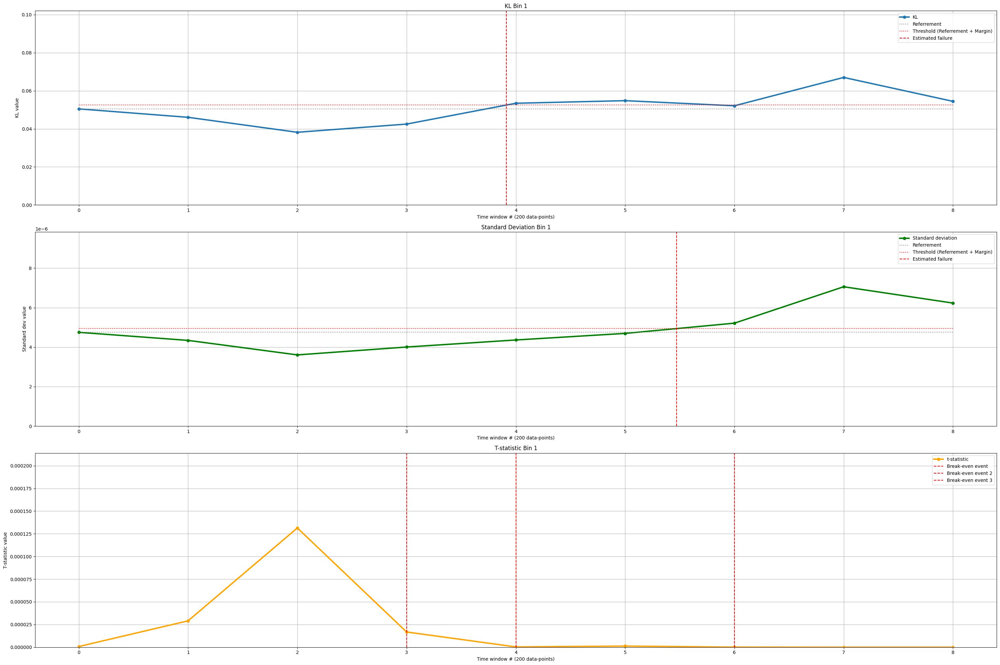

In [40]:
fig, (ax0, ax1, ax2) = plt.subplots(figsize=(30, 20), nrows=3)

ax0.plot(eval_KL_y[0][break_in_offset:], label='KL', marker='o', linewidth=3)
ax0.set_title("KL Bin 1")
ax0.set_xlabel("Time window # ({} data-points)".format(minutes))
ax0.set_ylabel("KL value")
ax0.hlines(event_kl_y[0][0], linestyles= "dotted", xmin= 0 , xmax= len(eval_KL_y[0]) -1, color= "gray", label= "Referrement")
ax0.hlines(event_kl_y[0][1], linestyles= "dotted", xmin= 0 , xmax= len(eval_KL_y[0]) -1, color= "red", label= "Threshold (Referrement + Margin)")
ax0.vlines(event_kl_y[0][2], linestyles= "dashed", ymin= 0 , ymax= 1, color= "red", label= "Estimated failure")
ax0.legend()
ax1.plot(eval_SD_y[0][break_in_offset:], label='Standard deviation', color= 'green', marker='o', linewidth=3)
ax1.set_title("Standard Deviation Bin 1")
ax1.set_xlabel("Time window # ({} data-points)".format(minutes))
ax1.set_ylabel("Standard dev value")
ax1.hlines(event_sd_y[0][0], linestyles= "dotted", xmin= 0 , xmax= len(eval_KL_y[0]) -1, color= "gray", label= "Referrement")
ax1.hlines(event_sd_y[0][1], linestyles= "dotted", xmin= 0 , xmax= len(eval_KL_y[0]) -1,  color= "red", label= "Threshold (Referrement + Margin)")
ax1.vlines(event_sd_y[0][2], linestyles= "dashed", ymin= 0 , ymax= 1, color= "red", label= "Estimated failure")
ax1.legend()
ax2.plot(eval_t_test_y[0][break_in_offset:], label='t-statistic', color= 'orange', marker='o', linewidth=3)
ax2.set_title("T-statistic Bin 1")
ax2.set_xlabel("Time window # ({} data-points)".format(minutes))
ax2.set_ylabel("T-statistic value")
if (event_t_y[0][0]> 0):
    ax2.vlines(event_t_y[0][0], linestyles= "dashed", ymin= 0 , ymax= 1, color= "red", label= "Break-even event")
    if (event_t_y[0][1]> 0):
        ax2.vlines(event_t_y[0][1], linestyles= "dashed", ymin= 0 , ymax= 1, color= "red", label= "Break-even event 2")
        if (event_t_y[0][2]> 0):
            ax2.vlines(event_t_y[0][2], linestyles= "dashed", ymin= 0 , ymax= 1, color= "red", label= "Break-even event 3")
ax2.legend()



ax0.set_ylim([0, np.average(eval_KL_y[0])* 2])
ax1.set_ylim([0, np.average(eval_SD_y[0])* 2])
ax2.set_ylim([0, np.average(eval_t_test_y[0][average_offset:]* 10)])

# ax3.set_ylim([0, np.average(eval_KL_y[1])* 2])
# ax4.set_ylim([0, np.average(eval_t_test_y[1][average_offset:])])
# ax5.set_ylim([0, np.average(eval_SD_y[1])* 2])

# ax6.set_ylim([0, np.average(eval_KL_y[2])* 2])
# ax7.set_ylim([0, np.average(eval_t_test_y[2][average_offset:])])
# ax8.set_ylim([0, np.average(eval_SD_y[2])* 2])

# ax9.set_ylim([0, np.average(eval_KL_y[3])* 2])
# ax10.set_ylim([0, np.average(eval_t_test_y[3][average_offset:])])
# ax11.set_ylim([0, np.average(eval_SD_y[3])* 2])

# ax12.set_ylim([0, np.average(eval_KL_y[4])* 2])
# ax13.set_ylim([0, np.average(eval_t_test_y[4][average_offset:])])
# ax14.set_ylim([0, np.average(eval_SD_y[4])* 2])


ax0.grid()
ax1.grid()
ax2.grid()
# ax3.grid()
# ax4.grid()
# ax5.grid()
# ax6.grid()
# ax7.grid()
# ax8.grid()
# ax9.grid()
# ax10.grid()
# ax11.grid()
# ax12.grid()
# ax13.grid()
# ax14.grid()

#fig.suptitle('Window size {} or {} minutes of recording'.format(window, minutes))
fig.tight_layout()

[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [norm      ] [0.00 sec] [RSS: 7.436e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 1.75637e+09] [loc=0.000 scale=0.000]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 1.75637e+09] [loc=-921.600 scale=921.600]
[distfit] >INFO> [dweibull  ] [0.08 sec] [RSS: 4.55246e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [t         ] [0.13 sec] [RSS: 3.80326e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [genextreme] [0.22 sec] [RSS: 1.23147e+09] [loc=0.000 scale=0.000]
[distfit] >INFO> [gamma     ] [0.11 sec] [RSS: 3.98467e+09] [loc=0.000 scale=1.311]
[distfit] >INFO> [lognorm   ] [0.16 sec] [RSS: 4.70635e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [beta      ] [0.17 sec] [RSS: 4.92426e+08] [loc=0.000 scale=17.556]
[distfit] >INFO> [uniform   ] [0.00 sec] [RSS: 2.32442e+09] [loc=0.000 scale=0.000]
[distfit] >INFO> [loggamma  ] [0.13 sec] [RSS: 7.76027e+08] [loc=-0.004 scale=0.001]
[distfit] >INFO> Comput

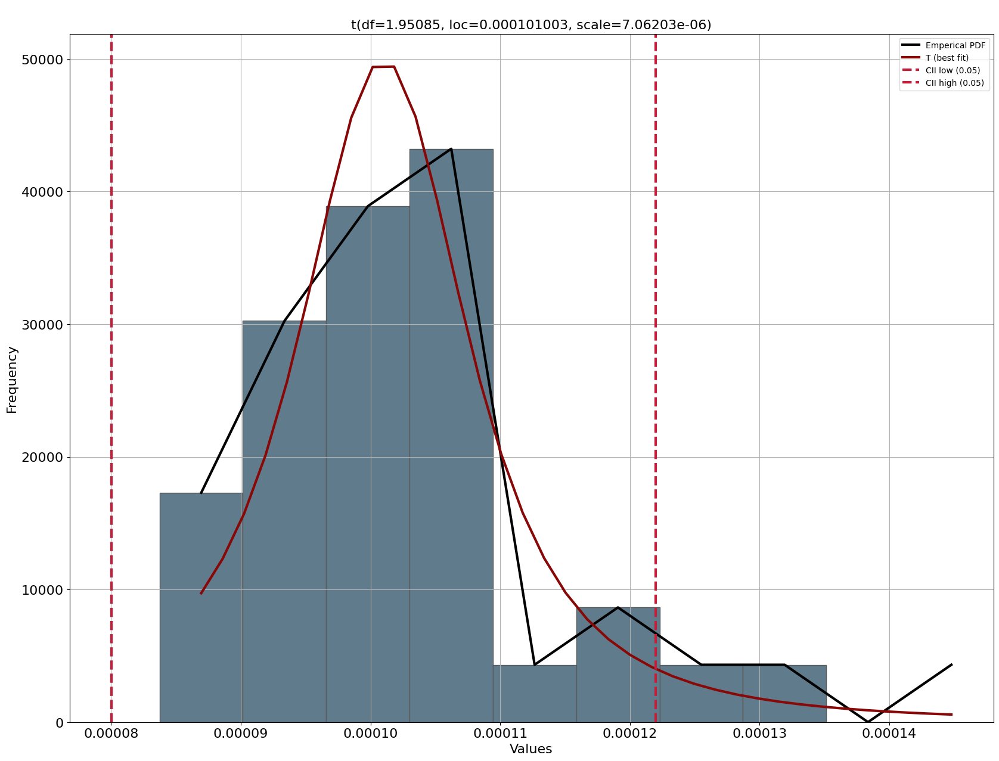

In [19]:
dfit = distfit(todf=True)
results = dfit.fit_transform(set1_good["B1_x_freq_band_1"].to_numpy())
im = dfit.plot()

[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [norm      ] [0.00 sec] [RSS: 2.53117e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 3.89808e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 3.89808e+08] [loc=-4096.000 scale=4096.000]
[distfit] >INFO> [dweibull  ] [0.04 sec] [RSS: 2.22223e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [t         ] [0.11 sec] [RSS: 2.53162e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [genextreme] [0.13 sec] [RSS: 2.6544e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [gamma     ] [0.02 sec] [RSS: 1.48659e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [lognorm   ] [0.13 sec] [RSS: 1.43382e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [beta      ] [0.13 sec] [RSS: 1.54442e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [uniform   ] [0.00 sec] [RSS: 4.41453e+08] [loc=0.000 scale=0.000]
[distfit] >INFO> [loggamma  ] [0.13 sec] [RSS: 2.53932e+08] [loc=-0.008 scale=0.001]
[distfit] >INFO> Comp

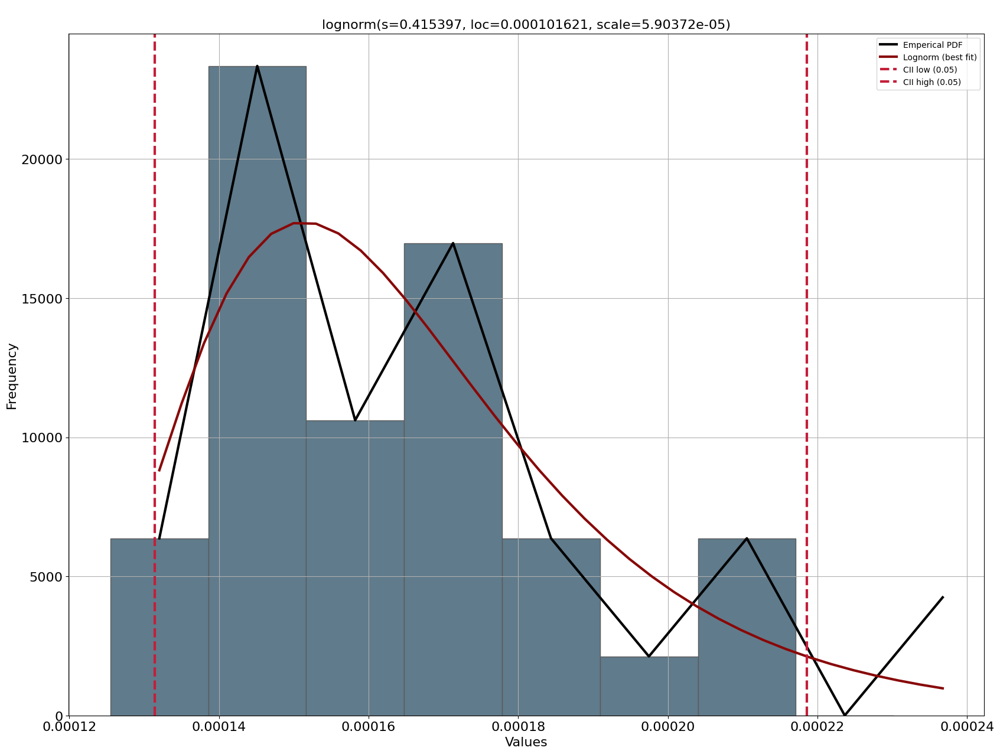

In [20]:
dfit = distfit(todf=True)
results = dfit.fit_transform(set1_bad["B1_x_freq_band_1"].to_numpy())
im = dfit.plot()

# Event assestment

In [11]:
from sksurv.datasets import load_veterans_lung_cancer
from sksurv.datasets import load_whas500
import re

In [12]:
pd.set_option('display.max_columns', None)
set1.describe()

,B1_x_mean,B1_x_std,B1_x_skew,B1_x_kurtosis,B1_x_entropy,B1_x_rms,B1_x_max,B1_x_p2p,B1_x_crest,B1_x_clearence,B1_x_shape,B1_x_impulse,B1_x_freq_band_1,B1_x_freq_band_2,B1_x_freq_band_3,B1_x_freq_band_4,B1_x_freq_band_5,B1_y_mean,B1_y_std,B1_y_skew,B1_y_kurtosis,B1_y_entropy,B1_y_rms,B1_y_max,B1_y_p2p,B1_y_crest,B1_y_clearence,B1_y_shape,B1_y_impulse,B1_y_freq_band_1,B1_y_freq_band_2,B1_y_freq_band_3,B1_y_freq_band_4,B1_y_freq_band_5,B2_x_mean,B2_x_std,B2_x_skew,B2_x_kurtosis,B2_x_entropy,B2_x_rms,B2_x_max,B2_x_p2p,B2_x_crest,B2_x_clearence,B2_x_shape,B2_x_impulse,B2_x_freq_band_1,B2_x_freq_band_2,B2_x_freq_band_3,B2_x_freq_band_4,B2_x_freq_band_5,B2_y_mean,B2_y_std,B2_y_skew,B2_y_kurtosis,B2_y_entropy,B2_y_rms,B2_y_max,B2_y_p2p,B2_y_crest,B2_y_clearence,B2_y_shape,B2_y_impulse,B2_y_freq_band_1,B2_y_freq_band_2,B2_y_freq_band_3,B2_y_freq_band_4,B2_y_freq_band_5,B3_x_mean,B3_x_std,B3_x_skew,B3_x_kurtosis,B3_x_entropy,B3_x_rms,B3_x_max,B3_x_p2p,B3_x_crest,B3_x_clearence,B3_x_shape,B3_x_impulse,B3_x_freq_band_1,B3_x_freq_band_2,B3_x_freq_band_3,B3_x_freq_band_4,B3_x_freq_band_5,B3_y_mean,B3_y_std,B3_y_skew,B3_y_kurtosis,B3_y_entropy,B3_y_rms,B3_y_max,B3_y_p2p,B3_y_crest,B3_y_clearence,B3_y_shape,B3_y_impulse,B3_y_freq_band_1,B3_y_freq_band_2,B3_y_freq_band_3,B3_y_freq_band_4,B3_y_freq_band_5,B4_x_mean,B4_x_std,B4_x_skew,B4_x_kurtosis,B4_x_entropy,B4_x_rms,B4_x_max,B4_x_p2p,B4_x_crest,B4_x_clearence,B4_x_shape,B4_x_impulse,B4_x_freq_band_1,B4_x_freq_band_2,B4_x_freq_band_3,B4_x_freq_band_4,B4_x_freq_band_5,B4_y_mean,B4_y_std,B4_y_skew,B4_y_kurtosis,B4_y_entropy,B4_y_rms,B4_y_max,B4_y_p2p,B4_y_crest,B4_y_clearence,B4_y_shape,B4_y_impulse,B4_y_freq_band_1,B4_y_freq_band_2,B4_y_freq_band_3,B4_y_freq_band_4,B4_y_freq_band_5
count,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000
mean,0.127485,0.098575,-0.038621,0.998634,4.981065,0.152221,0.726346,1.177997,4.774991,0.111784,1.194091,5.702422,0.000124,0.000122,0.000123,0.000123,0.000122,0.124183,0.088983,0.066461,1.104286,4.888106,0.145987,0.649487,1.162676,4.449841,0.110128,1.175567,5.231798,0.000020,0.000020,0.000020,0.000020,0.000020,0.125529,0.094435,-0.060657,0.257696,5.042373,0.149490,0.654877,0.969776,4.384137,0.109975,1.191009,5.222042,0.000019,0.000018,0.000019,0.000018,0.000018,0.120615,0.078210,-0.041243,0.396061,4.870424,0.139714,0.550559,0.810000,3.943465,0.108119,1.158586,4.569677,0.000018,0.000018,0.000018,0.000018,0.0000

In [13]:
set2.describe()

,B1_mean,B1_std,B1_skew,B1_kurtosis,B1_entropy,B1_rms,B1_max,B1_p2p,B1_crest,B1_clearence,B1_shape,B1_impulse,B1_freq_band_1,B1_freq_band_2,B1_freq_band_3,B1_freq_band_4,B1_freq_band_5,B2_mean,B2_std,B2_skew,B2_kurtosis,B2_entropy,B2_rms,B2_max,B2_p2p,B2_crest,B2_clearence,B2_shape,B2_impulse,B2_freq_band_1,B2_freq_band_2,B2_freq_band_3,B2_freq_band_4,B2_freq_band_5,B3_mean,B3_std,B3_skew,B3_kurtosis,B3_entropy,B3_rms,B3_max,B3_p2p,B3_crest,B3_clearence,B3_shape,B3_impulse,B3_freq_band_1,B3_freq_band_2,B3_freq_band_3,B3_freq_band_4,B3_freq_band_5,B4_mean,B4_std,B4_skew,B4_kurtosis,B4_entropy,B4_rms,B4_max,B4_p2p,B4_crest,B4_clearence,B4_shape,B4_impulse,B4_freq_band_1,B4_freq_band_2,B4_freq_band_3,B4_freq_band_4,B4_freq_band_5
count,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,9.840000e+02,9.840000e+02,984.000000,9.840000e+02,9.840000e+02,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,9.840000e+02,9.840000e+02,984.000000,9.840000e+02,9.840000e+02,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,9.840000e+02,9.840000e+02,984.000000,9.840000e+02,9.840000e+02,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,9.840000e+02,9.840000e+02,984.000000,9.840000e+02,9.840000e+02
mean,0.080905,0.106090,-0.033128,0.827643,4.985907,0.106111,0.555001,1.054736,5.173858,0.066902,1.296405,6.711368,3.926966e-05,3.920027e-05,0.000040,3.923254e-05,3.950220e-05,0.078532,0.098731,0.107981,0.153366,5.084825,0.098753,0.478901,0.897540,4.868480,0.066344,1.257841,6.124137,8.234469e-06,8.254677e-06,0.000009,8.288174e-06,8.452883e-06,0.081356,0.104642,0.017181,1.330907,4.903246,0.104657,0.771296,1.427307,7.437919,0.068108,1.288127,9.591613,3.778003e-06,3.746269e-06,0.000004,3.738005e-06,3.754112e-06,0.047822,0.060193,-0.001421,0.141999,4.597510,0.060269,0.277990,0.527398,4.627469,0.040248,1.259826,5.830336,8.234469e-06,8.254677e-06,0.000009,8.288174e-06,8.452883e-06
std,0.040171,0.058234,0.089037,0.966001,0.260572,0.058225,0.388084,0.740102,0.576191,0.032068,0.047856,0.838301,1.280745e-05,1.317448e-05,0.000016,1.199531e-05,1.320641e-05,0.011779,0.014757,0.050775,0.145697,0.216527,0.014737,0.072462,0.121551,0.594936,0.010023,0.014118,0.754826,3.423904e-06,3.454859e-06,0.000005,3.281463e-06,3.825886e-06,0.011596,0.013708,0.057244,0.582909,0.235998,0.013687,0.117718,0.189793,1.278735,0.010097,0.019350,1.701840,2.133748e-06,2.018584e-06,0.000002,2.050313e-06,1.863187e-06,0.009541,0.012207,0.058087,0.118365,0.224410,0.012190,0.055503,0.098904,0.526149,0.008014,0.006188,0.667348,3.423904e-06,3.454859e-06,0.000005,3.281463e-06,3.825886e-06
min,0.001168,0.000987,-0.766212,-1.609923,0.592386,0.001533,0.005000,0.005000,2.377538,0.000681,1.132585,2.692763,3.409065e-07,6.097982e-07,0.000000,5.314790e-07,7.173398e-07,0.000767,0.001021,-0.289775,-1.871133,0.696544,0.001239,0.002000,0.004000,1.614661,0.000294,1.076729,1.875882,1.057994e-07,8.019454e-08,0.000000,6.510735e-08,8.370944e-08,0.000716,0.000996,-0.395600,-1.935553,0.697379,0.001197,0.005000,0.007000,1.772043,0.000256,1.080514,1.914718,2.011928e-08,1.724509e-08,0.000000,4.023855e-08,6.975787e-08,0.001699,0.001204,-0.659188,-0.341222,0.758412,0.002124,0.005000,0.007000,2.321614,0.001220,1.205914,2.799666,1.057994e-07,8.019454e-08,0.000000,6.510735e-08,8.370944e-08
25%,0.060765,0.077112,-0.047476,0.393975,4.860787,0.077136,0.393000,0.752000,4.816641,0.051044,1.268817,6.187471,3.186016e-05,3.202953e-05,0.000032,3.232074e-05,3.222777e-05,0.074233,0.093402,0.095795,0.112662,5.051643,0.093420,0.435000,0.827000,4.484116,0.062686,1.255636,5.645529,6.228226e-06,6.312098e-06,0.000006,6.433705e-06,6.388298e-06,0.076832,0.099288,-0.019113,1.073366,4.833062,0.099307,0.688000,1.293250,6.581185,0

In [172]:
set3.describe()

,B1_mean,B1_std,B1_skew,B1_kurtosis,B1_entropy,B1_rms,B1_max,B1_p2p,B1_crest,B1_clearence,B1_shape,B1_impulse,B1_freq_band_1,B1_freq_band_2,B1_freq_band_3,B1_freq_band_4,B1_freq_band_5,B2_mean,B2_std,B2_skew,B2_kurtosis,B2_entropy,B2_rms,B2_max,B2_p2p,B2_crest,B2_clearence,B2_shape,B2_impulse,B2_freq_band_1,B2_freq_band_2,B2_freq_band_3,B2_freq_band_4,B2_freq_band_5,B3_mean,B3_std,B3_skew,B3_kurtosis,B3_entropy,B3_rms,B3_max,B3_p2p,B3_crest,B3_clearence,B3_shape,B3_impulse,B3_freq_band_1,B3_freq_band_2,B3_freq_band_3,B3_freq_band_4,B3_freq_band_5,B4_mean,B4_std,B4_skew,B4_kurtosis,B4_entropy,B4_rms,B4_max,B4_p2p,B4_crest,B4_clearence,B4_shape,B4_impulse,B4_freq_band_1,B4_freq_band_2,B4_freq_band_3,B4_freq_band_4,B4_freq_band_5
count,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6.324000e+03,6.324000e+03,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6.324000e+03,6.324000e+03,6.324000e+03,6.324000e+03,6.324000e+03,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6.324000e+03,6.324000e+03,6.324000e+03,6.324000e+03,6.324000e+03,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6324.000000,6.324000e+03,6.324000e+03,6.324000e+03,6.324000e+03,6.324000e+03
mean,0.058445,0.074130,0.021646,0.432336,4.815292,0.074168,0.402556,0.754292,5.416952,0.049120,1.268883,6.875770,3.081080e-05,3.072543e-05,0.000031,0.000031,0.000031,0.064602,0.080927,0.123095,0.167833,4.900028,0.081042,0.418893,0.774712,5.178479,0.054647,1.254529,6.497769,6.119042e-06,6.079432e-06,6.073632e-06,6.090818e-06,6.082799e-06,0.057390,0.072356,0.009316,0.151545,4.755840,0.072389,0.344704,0.649311,4.701264,0.048341,1.259200,5.921923,2.720119e-06,2.699288e-06,2.744361e-06,2.713870e-06,2.707668e-06,0.044168,0.055622,0.015498,0.185292,4.522403,0.055725,0.262515,0.498059,4.734928,0.037134,1.261629,5.974201,6.119042e-06,6.079432e-06,6.073632e-06,6.090818e-06,6.082799e-06
std,0.005061,0.006521,0.035822,0.179963,0.076473,0.006517,0.072424,0.116342,0.762777,0.004245,0.006449,0.987079,8.876974e-06,7.960339e-06,0.000008,0.000009,0.000008,0.009270,0.011431,0.035749,0.116006,0.093418,0.011528,0.069013,0.112964,0.639154,0.007909,0.005936,0.812467,2.480712e-06,2.139550e-06,2.225080e-06,2.341786e-06,2.129431e-06,0.023149,0.030735,0.056349,0.402732,0.120221,0.030752,0.229934,0.379973,0.573759,0.019234,0.009095,0.752342,1.482230e-06,1.351309e-06,1.493253e-06,1.455252e-06,1.389481e-06,0.011082,0.013997,0.031363,0.086213,0.136094,0.013988,0.056112,0.103151,0.504437,0.009343,0.004463,0.641540,2.480712e-06,2.139550e-06,2.225080e-06,2.341786e-06,2.129431e-06
min,0.001533,0.001143,-0.223003,0.021923,0.756613,0.001912,0.005000,0.007000,2.615010,0.001067,1.247146,3.261299,7.561088e-07,6.360537e-07,0.000001,0.000001,0.000001,0.002441,0.001351,-0.303473,-0.460145,0.730280,0.002789,0.007000,0.007000,2.509516,0.002176,1.126212,2.868207,1.775264e-07,2.040013e-07,2.522910e-07,3.212228e-07,3.015939e-07,0.003663,0.001520,-1.648595,-1.826541,0.733937,0.003966,0.007000,0.007000,1.765121,0.003491,1.082683,1.911068,1.070657e-07,1.378681e-07,1.367763e-07,1.001635e-07,1.216599e-07,0.001428,0.001187,-0.246081,-0.530781,0.801887,0.001850,0.005000,0.007000,2.702112,0.000922,1.216961,3.501881,1.775264e-07,2.040013e-07,2.522910e-07,3.212228e-07,3.015939e-07
25%,0.056456,0.071425,-0.000022,0.314121,4.785344,0.071466,0.356000,0.681000,4.904327,0.047506,1.264410,6.214020,2.623913e-05,2.647754e-05,0.000026,0.000026,0.000026,0.061598,0.077213,0.102789,0.094570,4.863620,0.077253,0.374000,0.708000,4.725303,0.052103,1.251202,5.924129,4.918880e-06,4.963781e-06,4.921550e-06,4.916273e-06,4.967478e-06,0.052594,0.066140,-0.0024

In [174]:
set1_temp= set1.drop(['B1_x_freq_band_1', 'B1_x_freq_band_2', 'B1_x_freq_band_3', 'B1_x_freq_band_4', 'B1_x_freq_band_5',
                      'B2_x_freq_band_1', 'B2_x_freq_band_2', 'B2_x_freq_band_3', 'B2_x_freq_band_4', 'B2_x_freq_band_5',
                      'B3_x_freq_band_1', 'B3_x_freq_band_2', 'B3_x_freq_band_3', 'B3_x_freq_band_4', 'B3_x_freq_band_5', 
                      'B4_x_freq_band_1', 'B4_x_freq_band_2', 'B4_x_freq_band_3', 'B4_x_freq_band_4', 'B4_x_freq_band_5',
                      'B1_y_freq_band_1', 'B1_y_freq_band_2', 'B1_y_freq_band_3', 'B1_y_freq_band_4', 'B1_y_freq_band_5',
                      'B2_y_freq_band_1', 'B2_y_freq_band_2', 'B2_y_freq_band_3', 'B2_y_freq_band_4', 'B2_y_freq_band_5',
                      'B3_y_freq_band_1', 'B3_y_freq_band_2', 'B3_y_freq_band_3', 'B3_y_freq_band_4', 'B3_y_freq_band_5', 
                      'B4_y_freq_band_1', 'B4_y_freq_band_2', 'B4_y_freq_band_3', 'B4_y_freq_band_4', 'B4_y_freq_band_5',                      
                      ], axis=1)

set2_temp= set2.drop(['B1_freq_band_1', 'B1_freq_band_2', 'B1_freq_band_3', 'B1_freq_band_4', 'B1_freq_band_5',
                      'B2_freq_band_1', 'B2_freq_band_2', 'B2_freq_band_3', 'B2_freq_band_4', 'B2_freq_band_5',
                      'B3_freq_band_1', 'B3_freq_band_2', 'B3_freq_band_3', 'B3_freq_band_4', 'B3_freq_band_5', 
                      'B4_freq_band_1', 'B4_freq_band_2', 'B4_freq_band_3', 'B4_freq_band_4', 'B4_freq_band_5'], axis=1)
set3_temp= set3.drop(['B1_freq_band_1', 'B1_freq_band_2', 'B1_freq_band_3', 'B1_freq_band_4', 'B1_freq_band_5',
                      'B2_freq_band_1', 'B2_freq_band_2', 'B2_freq_band_3', 'B2_freq_band_4', 'B2_freq_band_5',
                      'B3_freq_band_1', 'B3_freq_band_2', 'B3_freq_band_3', 'B3_freq_band_4', 'B3_freq_band_5', 
                      'B4_freq_band_1', 'B4_freq_band_2', 'B4_freq_band_3', 'B4_freq_band_4', 'B4_freq_band_5'], axis=1)



In [16]:
set1_temp.describe()

,B1_x_mean,B1_x_std,B1_x_skew,B1_x_kurtosis,B1_x_entropy,B1_x_rms,B1_x_max,B1_x_p2p,B1_x_crest,B1_x_clearence,B1_x_shape,B1_x_impulse,B1_y_mean,B1_y_std,B1_y_skew,B1_y_kurtosis,B1_y_entropy,B1_y_rms,B1_y_max,B1_y_p2p,B1_y_crest,B1_y_clearence,B1_y_shape,B1_y_impulse,B2_x_mean,B2_x_std,B2_x_skew,B2_x_kurtosis,B2_x_entropy,B2_x_rms,B2_x_max,B2_x_p2p,B2_x_crest,B2_x_clearence,B2_x_shape,B2_x_impulse,B2_y_mean,B2_y_std,B2_y_skew,B2_y_kurtosis,B2_y_entropy,B2_y_rms,B2_y_max,B2_y_p2p,B2_y_crest,B2_y_clearence,B2_y_shape,B2_y_impulse,B3_x_mean,B3_x_std,B3_x_skew,B3_x_kurtosis,B3_x_entropy,B3_x_rms,B3_x_max,B3_x_p2p,B3_x_crest,B3_x_clearence,B3_x_shape,B3_x_impulse,B3_y_mean,B3_y_std,B3_y_skew,B3_y_kurtosis,B3_y_entropy,B3_y_rms,B3_y_max,B3_y_p2p,B3_y_crest,B3_y_clearence,B3_y_shape,B3_y_impulse,B4_x_mean,B4_x_std,B4_x_skew,B4_x_kurtosis,B4_x_entropy,B4_x_rms,B4_x_max,B4_x_p2p,B4_x_crest,B4_x_clearence,B4_x_shape,B4_x_impulse,B4_y_mean,B4_y_std,B4_y_skew,B4_y_kurtosis,B4_y_entropy,B4_y_rms,B4_y_max,B4_y_p2p,B4_y_crest,B4_y_clearence,B4_y_shape,B4_y_impulse
count,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000,2156.000000
mean,0.127485,0.098575,-0.038621,0.998634,4.981065,0.152221,0.726346,1.177997,4.774991,0.111784,1.194091,5.702422,0.124183,0.088983,0.066461,1.104286,4.888106,0.145987,0.649487,1.162676,4.449841,0.110128,1.175567,5.231798,0.125529,0.094435,-0.060657,0.257696,5.042373,0.149490,0.654877,0.969776,4.384137,0.109975,1.191009,5.222042,0.120615,0.078210,-0.041243,0.396061,4.870424,0.139714,0.550559,0.810000,3.943465,0.108119,1.158586,4.569677,0.132830,0.115430,-0.014059,1.978246,4.952210,0.161843,0.965141,1.613053,5.823603,0.114804,1.216853,7.122021,0.134874,0.119365,-0.002986,0.837188,5.061513,0.164638,0.842283,1.416248,5.049719,0.116325,1.219512,6.170537,0.124395,0.091736,0.013414,2.101887,4.810978,0.146809,0.726759,1.222874,4.794088,0.110735,1.176504,5.698702,0.125285,0.095251,0.027031,2.164625,4.842208,0.148647,0.761834,1.314533,4.983898,0.110994,1.183745,5.952366
std,0.006072,0.005345,0.030224,0.197405,0.074409,0.007184,0.079033,0.107634,0.500902,0.005428,0.006763,0.605757,0.006244,0.005293,0.040886,0.308200,0.086329,0.007431,0.089334,0.131975,0.568302,0.005517,0.006380,0.674852,0.005745,0.006367,0.025643,0.098410,0.051518,0.006739,0.074361,0.096463,0.489376,0.005233,0.009356,0.589167,0.005540,0.005635,0.028658,0.113075,0.053630,0.006122,0.060915,0.082006,0.428424,0.005348,0.012222,0.507128,0.014742,0.023826,0.182831,5.513139,0.271034,0.021728,0.594369,0.967743,2.962732,0.011722,0.018377,3.770543,0.014387,0.022346,0.054520,1.245597,0.179755,0.020355,0.346841,0.626251,1.526212,0.011544,0.013553,1.936097,0.014100,0.028382,0.084061,3.453938,0.204558,0.021527,0.398196,0.750161,1.888142,0.010712,0.043752,2.515634,0.013661,0.025358,0.084643,3.346159,0.190066,0.019972,0.395722,0.713627,1.876039,0.010863,0.038067,2.498653
min,0.103651,0.079417,-0.137060,0.2

In [102]:
def load_bearing_data(sets):

    row = pd.DataFrame()
    data_cov= pd.DataFrame()

    # df_sa = pd.DataFrame([[False, 101.],[False, 102.], [False, 101.], [False, 102.], 
    #                    [True, 60.], [True, 75.], [True, 64.], [True, 62.],
    #                    [True, 57.], [False, 102.], [False, 103.], [False, 101.], 
    #                    [False, 101.], [False, 104.], [True, 91.], [False, 102.]], columns=['Status', 'Time'])
    df_sa = pd.DataFrame([[False, 90.],[False, 92.], [False, 101.], [False, 102.], 
                [True, 60.], [True, 75.], [True, 64.], [True, 62.],
                [True, 57.], [False, 102.], [False, 100.], [False, 95.], 
                [False, 96.], [False, 98.], [True, 91.], [False, 102.]], columns=['Status', 'Time'])
    df_sa = df_sa[['Status', 'Time']].to_numpy()
    df_sa = [(e1,e2) for e1,e2 in df_sa]
    data_sa= np.array(df_sa, dtype=[('Status', '?'), ('Survival_in_days', '<f8')])

    i= 1
    j= 1

    for set in sets:
        for column in set:

            if (column== "time"):
                continue
            
            columnSeriesObj = set[column]
    #       temp_label_bno = re.findall("^B+\d", column)
    #        temp_label_bno= "B" + str(j) + "_"
            temp_label_cov= ""

            if re.findall(r"mean\b", column):
                temp_label_cov = re.findall(r"mean\b", column)[0]
            elif re.findall(r"std\b", column):
                temp_label_cov = re.findall(r"std\b", column)[0]
            elif re.findall(r"skew\b", column):
                temp_label_cov = re.findall(r"skew\b", column)[0]
            elif re.findall(r"kurtosis\b", column):
                temp_label_cov = re.findall(r"kurtosis\b", column)[0]
            elif re.findall(r"entropy\b", column):
                temp_label_cov = re.findall(r"entropy\b", column)[0]
            elif re.findall(r"rms\b", column):
                temp_label_cov = re.findall(r"rms\b", column)[0]
            elif re.findall(r"max\b", column):
                temp_label_cov = re.findall(r"max\b", column)[0]
            elif re.findall(r"p2p\b", column):
                temp_label_cov = re.findall(r"p2p\b", column)[0]
            elif re.findall(r"crest\b", column):
                temp_label_cov = re.findall(r"crest\b", column)[0]
            elif re.findall(r"clearence\b", column):
                temp_label_cov = re.findall(r"clearence\b", column)[0]
            elif re.findall(r"shape\b", column):
                temp_label_cov = re.findall(r"shape\b", column)[0]
            elif re.findall(r"impulse\b", column):
                temp_label_cov = re.findall(r"impulse\b", column)[0]
            
            label= temp_label_cov
            
            row [label]= pd.Series(np.mean(columnSeriesObj.values)).T

            if i> 11:
                i= 1
                data_cov = pd.concat([data_cov, row], ignore_index= True)
                j += 1
            else:
                i += 1

        i= 1
        row = pd.DataFrame()

    return data_cov, data_sa 

In [103]:
data_x, data_y = load_bearing_data([set1_temp, set2_temp, set3_temp])
data_y

array([(False,  90.), (False,  92.), (False, 101.), (False, 102.),
       ( True,  60.), ( True,  75.), ( True,  64.), ( True,  62.),
       ( True,  57.), (False, 102.), (False, 100.), (False,  95.),
       (False,  96.), (False,  98.), ( True,  91.), (False, 102.)],
      dtype=[('Status', '?'), ('Survival_in_days', '<f8')])

# Survival analysis tests

In [104]:
%matplotlib inline
import matplotlib.pyplot as plt
from sksurv.nonparametric import kaplan_meier_estimator
from sksurv.preprocessing import OneHotEncoder
from sklearn import set_config
from sksurv.linear_model import CoxPHSurvivalAnalysis
from sklearn import set_config
from sksurv.linear_model import CoxPHSurvivalAnalysis
from sksurv.metrics import concordance_index_censored

Text(0.5, 0, 'time $t$')

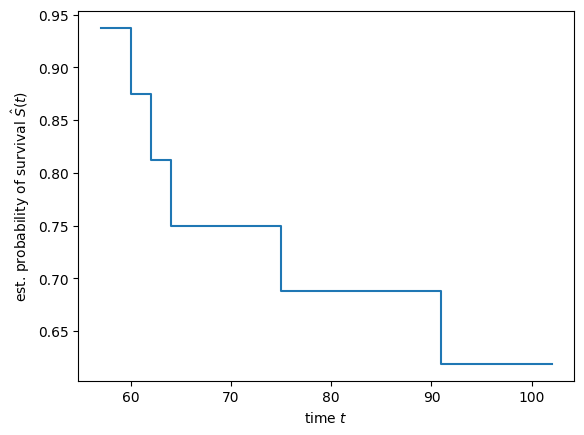

In [105]:
time, survival_prob = kaplan_meier_estimator(data_y["Status"], data_y["Survival_in_days"])
plt.step(time, survival_prob, where="post")
plt.ylabel("est. probability of survival $\hat{S}(t)$")
plt.xlabel("time $t$")

In [163]:
data_x_numeric = OneHotEncoder().fit_transform(data_x)
print (data_x_numeric.head())
data_x_numeric = data_x_numeric.loc[0:12, :]
data_x_test = data_x.loc[13:15, :]
data_x_numeric.head()
# data_x_test.head()

       mean       std      skew  kurtosis   entropy       rms       max  \
0  0.127485  0.098575 -0.038621  0.998634  4.981065  0.152221  0.726346   
1  0.124183  0.088983  0.066461  1.104286  4.888106  0.145987  0.649487   
2  0.125529  0.094435 -0.060657  0.257696  5.042373  0.149490  0.654877   
3  0.120615  0.078210 -0.041243  0.396061  4.870424  0.139714  0.550559   
4  0.132830  0.115430 -0.014059  1.978246  4.952210  0.161843  0.965141   

        p2p     crest  clearence     shape   impulse  
0  1.177997  4.774991   0.111784  1.194091  5.702422  
1  1.162676  4.449841   0.110128  1.175567  5.231798  
2  0.969776  4.384137   0.109975  1.191009  5.222042  
3  0.810000  3.943465   0.108119  1.158586  4.569677  
4  1.613053  5.823603   0.114804  1.216853  7.122021  


,mean,std,skew,kurtosis,entropy,rms,max,p2p,crest,clearence,shape,impulse
0,0.127485,0.098575,-0.038621,0.998634,4.981065,0.152221,0.726346,1.177997,4.774991,0.111784,1.194091,5.702422
1,0.124183,0.088983,0.066461,1.104286,4.888106,0.145987,0.649487,1.162676,4.449841,0.110128,1.175567,5.231798
2,0.125529,0.094435,-0.060657,0.257696,5.042373,0.149490,0.654877,0.969776,4.384137,0.109975,1.191009,5.222042
3,0.120615,0.078210,-0.041243,0.396061,4.870424,0.139714,0.550559,0.810000,3.943465,0.108119,1.158586,4.569677
4,0.132830,0.115430,-0.014059,1.978246,4.952210,0.161843,0.965141,1.613053,5.823603,0.114804,1.216853,7.122021


In [169]:
set_config(display="text")  # displays text representation of estimators

estimator = CoxPHSurvivalAnalysis(alpha= 0.1)
estimator.fit(data_x_numeric, data_y[0:13])
pd.Series(estimator.coef_, index=data_x_numeric.columns)

mean        -0.046464
std          0.290509
skew        -0.571185
kurtosis     1.619209
entropy      1.301326
rms          0.035518
max          0.645372
p2p          1.631232
crest       -1.635228
clearence   -0.083412
shape        0.740678
impulse      0.917038
dtype: float64

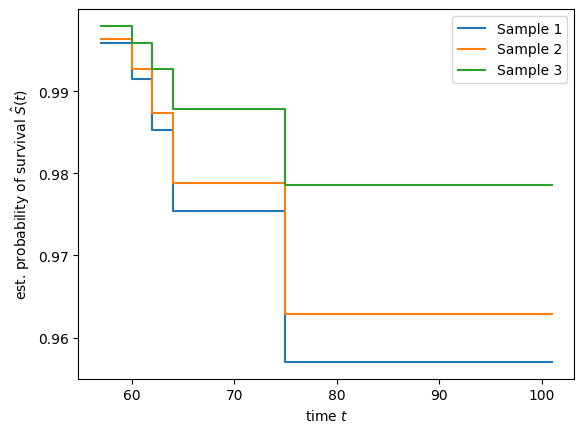

In [170]:
pred_surv = estimator.predict_survival_function(data_x_test)
time_points = np.arange(57, 102)
for i, surv_func in enumerate(pred_surv):
    plt.step(time_points, surv_func(time_points), where="post",
             label="Sample %d" % (i + 1))
plt.ylabel("est. probability of survival $\hat{S}(t)$")
plt.xlabel("time $t$")
plt.legend(loc="best")

In [171]:
estimator.score(data_x_test, data_y[13:16])

0.5

In [12]:
from lifelines import CoxPHFitter

In [13]:
rossi = load_rossi()
cph = CoxPHFitter()
cph.fit(rossi, 'week', 'arrest')

<lifelines.CoxPHFitter: fitted with 432 total observations, 318 right-censored observations>

     week  arrest  fin  age  race  wexp  mar  paro  prio
0      20       1    0   27     1     0    0     1     3
1      17       1    0   18     1     0    0     1     8
2      25       1    0   19     0     1    0     1    13
3      52       0    1   23     1     1    1     1     1
4      52       0    0   19     0     1    0     1     3
..    ...     ...  ...  ...   ...   ...  ...   ...   ...
427    52       0    1   31     0     1    0     1     3
428    52       0    0   20     1     0    0     1     1
429    52       0    1   20     1     1    1     1     1
430    52       0    0   29     1     1    0     1     3
431    52       0    1   24     1     1    0     1     1

[432 rows x 9 columns]
The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional haza

<lifelines.StatisticalResult: proportional_hazard_test>
 null_distribution = chi squared
degrees_of_freedom = 1
             model = <lifelines.CoxPHFitter: fitted with 432 total observations, 318 right-censored observations>
         test_name = proportional_hazard_test

---
           test_statistic      p  -log2(p)
age  km             11.03 <0.005     10.12
     rank           11.45 <0.005     10.45
fin  km              0.02   0.89      0.17
     rank            0.02   0.90      0.15
mar  km              0.60   0.44      1.19
     rank            0.71   0.40      1.32
paro km              0.12   0.73      0.45
     rank            0.13   0.71      0.49
prio km              0.02   0.88      0.18
     rank            0.02   0.89      0.17
race km              1.44   0.23      2.12
     rank            1.43   0.23      2.11
wexp km              7.48   0.01      7.32
     rank            7.31   0.01      7.19



1. Variable 'age' failed the non-proportional test: p-value is 0.0007.

   Advice 1: the functional form of the variable 'age' might be incorrect. That is, there may be
non-linear terms missing. The proportional hazard test used is very sensitive to incorrect
functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'age' using pd.cut, and then specify it in `strata=['age',
...]` in the call in `.fit`. See documentation in link [B] below.

   Advice 3: try adding an interaction term with your time variable. See documentation in link [C]
below.


   Bootstrapping lowess lines. May take a moment...


2. Variable 'wexp' failed the non-proportional test: p-value is 0.0063.

   Advice: with so few unique values (only 2), you can include `strata=['wexp', ...]` in the call in
`.fit`. See documentation in link [E] below.

   Bootstrapping lowess lines. May take a moment...


---
[A]  https://lifelines.readthedocs.io/en/l

[[<AxesSubplot:xlabel='rank-transformed time\n(p=0.0007)'>,
  <AxesSubplot:xlabel='km-transformed time\n(p=0.0009)'>],
 [<AxesSubplot:xlabel='rank-transformed time\n(p=0.0068)'>,
  <AxesSubplot:xlabel='km-transformed time\n(p=0.0063)'>]]

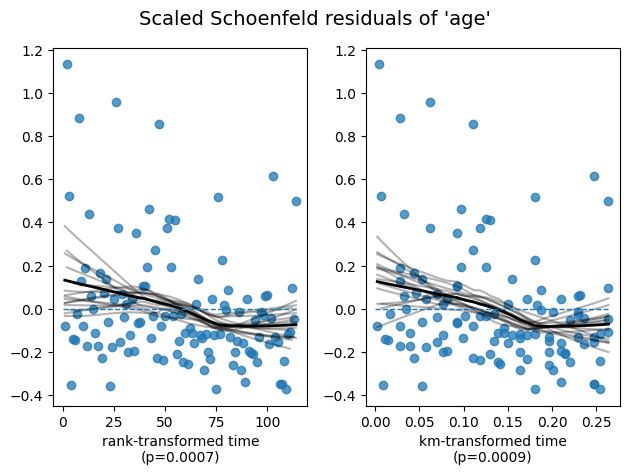

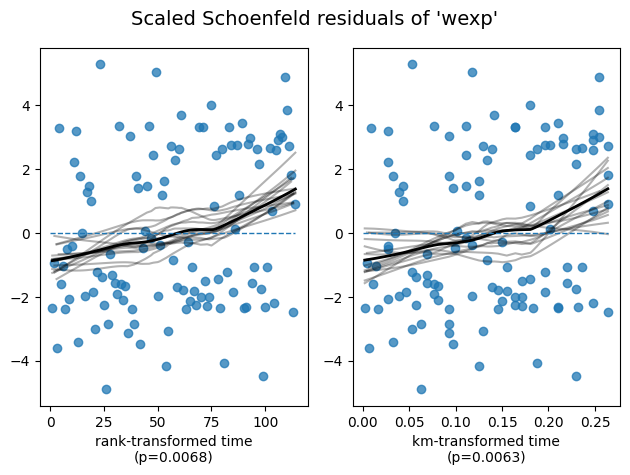

In [14]:
print (rossi)
cph.check_assumptions(rossi, p_value_threshold=0.05, show_plots=True)

In [ ]:
from pysurvival.models.semi_parametric import CoxPHModel
from pysurvival.models.multi_task import LinearMultiTaskModel
from pysurvival.datasets import Dataset
from pysurvival.utils.metrics import concordance_index

In [ ]:
X_train, T_train, E_train, X_test, T_test, E_test = \
    Dataset('simple_example').load_train_test()

In [3]:
row = pd.DataFrame()
data_sa = pd.DataFrame()
data_cov= pd.DataFrame()

# df_sa = pd.DataFrame([[False, 101.],[False, 102.], [False, 101.], [False, 102.], 
#                    [True, 60.], [True, 75.], [True, 64.], [True, 62.],
#                    [True, 57.], [False, 102.], [False, 103.], [False, 101.], 
#                    [False, 101.], [False, 104.], [True, 91.], [False, 102.]], columns=['Event', 'Survival_time'])
# df_sa = pd.DataFrame([[False, 90.],[False, 92.], [True, 101.], [False, 102.], 
#             [True, 60.], [True, 75.], [True, 64.], [True, 62.],
#             [True, 57.], [True, 102.], [False, 100.], [False, 95.], 
#             [True, 96.], [False, 98.], [True, 91.], [True, 102.]], columns=['Event', 'Survival_time'])

event= [False, False, True, False, True, True, True, True, True, True, False, False, True, False, True, True]
time_to_event= [90,92, 101, 102, 60, 75, 64, 62, 57, 102, 100, 95, 96, 98, 91, 102]


data_sa ['Event']= pd.Series(event).T
data_sa ['Survival_time']= pd.Series(time_to_event).T

print (data_sa)

    Event  Survival_time
0   False             90
1   False             92
2    True            101
3   False            102
4    True             60
5    True             75
6    True             64
7    True             62
8    True             57
9    True            102
10  False            100
11  False             95
12   True             96
13  False             98
14   True             91
15   True            102
